# Cohort-level Comparison of T2-w MRI Intensity Standardization Methods in Head and Neck Cancer for Quantitative Imaging Applications 

# Table of contents
1. [Introduction](#introduction)
2. [Dependencies](#dependencies)
    1. [Library Imports](#imports)
    2. [File Generation](#files)
3. [Main manuscript](#maintext)
    1. [Functions](#functions)
    2. [HOM Cohort](#HOM)
    3. [HET Cohort](#HET)
    4. [P-Value Heatmap](#pval)
4. [Supplementary Data](#appendix)
    1. [Simulation Studies](#sim)
        1. [S1c S2c determination](#sim1)
        2. [Scale invariance](#sim2)
        3. [Properties](#sim3)
    2. [External Mask Approximation](#approx)
    3. [Additional Functions](#functions2)
    4. [Complete T2-w Data (histograms, images, radiomics)](#T2)
    5. [Complete T1-w Dixon Data (histograms, images, SD NMIc)](#T1)
    6. [Complete CT Data (histograms, images, SD NMIc)](#CT)

# Introduction <a name="introduction"></a>

This is a notebook for the project "MRI Intensity Standardization Evaluation Design for Head and Neck Quantitative Imaging Applications" by the Fuller Lab at MD Anderson Cancer Center. An overview of the workflow is shown in the figure below. 

<div>
<img src="workflow.png">
</div>

This notebook asssumes the .ipynb file is nested inside a folder containing the two cohort folders with a directory structure as such:

In [1]:
"""
Master_folder/
├── T2_Intensity_Standardization.ipynb
├── HET_cohort/
│   ├──Patient folders (5 patients)
│      ├──Modality folders (T2)
│         ├──DICOM files (modality.SOPUID.dcm)
│         ├──RT struct file (str.dcm)
├── HOM_cohort/
│   ├──Patient folders (5 patients)
│      ├──Modality folders (T2, CT, DIXON)
│         ├──DICOM files (modality_slice.dcm)
│         ├──RT struct file (str.dcm)
"""

'\nMaster_folder/\n├── T2_Intensity_Standardization.ipynb\n├── HET_cohort/\n│   ├──Patient folders (5 patients)\n│      ├──Modality folders (T2)\n│         ├──DICOM files (modality.SOPUID.dcm)\n│         ├──RT struct file (str.dcm)\n├── HOM_cohort/\n│   ├──Patient folders (5 patients)\n│      ├──Modality folders (T2, CT, DIXON)\n│         ├──DICOM files (modality_slice.dcm)\n│         ├──RT struct file (str.dcm)\n'

The names and nested structure of the folders must adhere to this convention exactly or the scripts below will not work since this notebook uses relative file paths. The patient cohort folders containing anonymized DICOM files can be obtained from Figshare (link to be added).

# Dependencies <a name="dependencies"></a>

## Library Imports <a name="imports"></a>

In [2]:
# importing neccessary libraries 

# system operations 
import os 
import sys
import shutil
import glob

# calculations
import numpy as np 
import pandas as pd
from math import floor

# plotting
import matplotlib.pyplot as plt 
from matplotlib.collections import QuadMesh
from matplotlib.text import Text
import seaborn as sns; sns.set(color_codes=True)

# stats
import pingouin as pg # pip install pingouin
from pingouin import pairwise_ttests

# image manipulation/processing
import SimpleITK as sitk # pip install SimpleITK
import nibabel as nib # pip install nibabel
import pydicom # pip install pydicom
from DicomRTTool.ReaderWriter import DicomReaderWriter # pip install DicomRTTool
from intensity_normalization.normalize import nyul # pip install git+git://github.com/jcreinhold/intensity-normalization.git
from radiomics import featureextractor # pip install pyradiomics

C:\Users\kawahid\Anaconda3\lib\site-packages\outdated\utils.py:18: OutdatedPackageWarning: The package pingouin is out of date. Your version is 0.3.8, the latest is 0.3.11.
Set the environment variable OUTDATED_IGNORE=1 to disable these warnings.
  **kwargs
C:\Users\kawahid\Anaconda3\lib\site-packages\outdated\utils.py:18: OutdatedPackageWarning: The package outdated is out of date. Your version is 0.2.0, the latest is 0.2.1.
Set the environment variable OUTDATED_IGNORE=1 to disable these warnings.
  **kwargs


The notebook should function properly as long as the following packages versions are installed: 
1. DicomRTTool version 0.3.5.
2. Intensity-normalization version 1.4.3.
3. Matplotlib version 3.3.2.
4. Nibabel version 3.1.0.
5. Numpy version 1.18.5 (required for Pyradiomics, newer version led to crashes).
6. Pandas version 1.1.3.
7. Pinguoin version 0.3.8.
8. Radiomics (pyradiomics) version 3.0.0.
9. Seaborn version 0.11.0.
10. SimpleITK version 1.2.4.

The notebook may possibly be run with newer versions of these libraries, but it is not gaurenteed. 

In [3]:
!pip list # list installed packages

Package                            Version
---------------------------------- -------------------
-atplotlib                         3.3.4
alabaster                          0.7.12
anaconda-client                    1.7.2
anaconda-navigator                 1.9.12
anaconda-project                   0.9.1
appdirs                            1.4.4
argh                               0.26.2
argon2-cffi                        20.1.0
asn1crypto                         1.4.0
astroid                            2.5
astropy                            4.2
async-generator                    1.10
atomicwrites                       1.4.0
attrs                              20.3.0
autopep8                           1.4.4
Babel                              2.9.0
backcall                           0.2.0
backports.functools-lru-cache      1.6.1
backports.shutil-get-terminal-size 1.0.0
backports.tempfile                 1.0
backports.weakref                  1.0.post1
bcrypt                             3.2.

## Neccessary File Generation <a name="files"></a>

Because this notebook is reliant on the histogram normalization method from Reinhold et al., which currently only works through input/output directories, we must first generate the required files. Lines of code below take approx. 10 mins to run. If the following lines of code have already been run (i.e. Nyul directories/files generated) they do not need to be rerun. Future iterations of this notebook may implement methods that have built in normalization instead of calls to path-based functions. The following lines of code will generate folders such that the new directory contents are:

In [4]:
"""
Master_folder/
├── T2_Intensity_Standardization.ipynb
├── HET_cohort/
│   ├──Patient folders (5 patients)
│      ├──Modality folders (T2)
│         ├──DICOM files (modality_slice.dcm)
│         ├──RT struct file (str.dcm)
├── HOM_cohort/
│   ├──Patient folders (5 patients)
│      ├──Modality folders (T2, CT, DIXON)
│         ├──DICOM files (modality.SOPUID.dcm)
│         ├──RT struct file (str.dcm)
├── HET_cohort_nyul/ <--- NEW
│   ├──Patient folders (5 patients)
│      ├──Modality folders (T2)
│         ├──nifti file (patient_hm.nii.gz)
├── HOM_cohort_nyul/ <--- NEW
│   ├──Patient folders (5 patients)
│      ├──Modality folders (T2, CT, DIXON)
│         ├──nifti file (patient_hm.nii.gz)
"""

chardet                            4.0.0
check-manifest                     0.43
cleo                               0.8.1
click                              7.1.2
clikit                             0.6.2
cloudpickle                        1.6.0
clyent                             1.2.2
colorama                           0.4.4
comtypes                           1.1.8
conda                              4.9.2
conda-build                        3.18.11
conda-package-handling             1.7.2
conda-verify                       3.4.2
contextlib2                        0.6.0.post1
crashtest                          0.3.1
cryptography                       3.4.6
cycler                             0.10.0
Cython                             0.29.22
cytoolz                            0.11.0
dask                               2021.3.0
dataclasses                        0.6
dcmrtstruct2nii                    1.0.19
debtcollector                      2.2.0
decorator                          4.4.2
def

'\nMaster_folder/\n├── T2_Intensity_Standardization.ipynb\n├── HET_cohort/\n│   ├──Patient folders (5 patients)\n│      ├──Modality folders (T2)\n│         ├──DICOM files (modality_slice.dcm)\n│         ├──RT struct file (str.dcm)\n├── HOM_cohort/\n│   ├──Patient folders (5 patients)\n│      ├──Modality folders (T2, CT, DIXON)\n│         ├──DICOM files (modality.SOPUID.dcm)\n│         ├──RT struct file (str.dcm)\n├── HET_cohort_nyul/ <--- NEW\n│   ├──Patient folders (5 patients)\n│      ├──Modality folders (T2)\n│         ├──nifti file (patient_hm.nii.gz)\n├── HOM_cohort_nyul/ <--- NEW\n│   ├──Patient folders (5 patients)\n│      ├──Modality folders (T2, CT, DIXON)\n│         ├──nifti file (patient_hm.nii.gz)\n'

pandas                             1.2.3
pandas-flavor                      0.2.0
pandocfilters                      1.4.3
paramiko                           2.7.2
parso                              0.5.2
partd                              1.1.0
pastel                             0.2.1
path                               15.1.2
pathlib2                           2.3.5
pathtools                          0.1.2
patsy                              0.5.1
pbr                                5.4.5
pep517                             0.8.2
pep8                               1.7.1
pexpect                            4.8.0
pickleshare                        0.7.5
Pillow                             8.1.2
pingouin                           0.3.8
pip                                21.0.1
pkginfo                            1.7.0
pluggy                             0.13.1
ply                                3.11
prettytable                        0.7.2
prometheus-client                  0.9.0
prompt-toolkit

In [5]:
def nyul_file_maker(cohort_path):
    """
    Generates a folder with images containing Nyul intensnity standardized nifti files from DICOM images in specific folder structure.
        Parameters:
            cohort_path (directory): Directory containing patients>modalities>DICOM files (images + structures).
        Returns:
            None (generates a folder that is used later in the notebook).
    """
    cohort = cohort_path.split('\\')[-1]
    main_path = os.path.dirname(cohort_path)
    export_path = os.path.join(main_path, cohort+'_nyul') 
    if cohort == "HOM_cohort":
        modality_list = ['CT', 'Dixon_F', 'T2'] # if you have any additional folders for modality add here 
    else:
        modality_list = ['T2']
    for modality in modality_list:
        for root, dirs, files in os.walk(cohort_path):
            for d in dirs: # look for the dirs, labeled with modality 
                if d.startswith(modality):
                    patient_path = os.path.join(root + '\\'+ d) # path to MRI modality for a given patient 
                    MRN = patient_path.split('\\')[-2] 
                    modality = patient_path.split('\\')[-1]

                    new_dir = os.path.join(export_path, MRN, modality)
                    if os.path.exists(new_dir):
                        shutil.rmtree(new_dir)
                    os.makedirs(new_dir)

                    Contour_Names = ['External_KW']
                    associations = {'External_KW(2)': 'External_KW'}
                    Dicom_reader = DicomReaderWriter(description='Examples', series_instances_dictionary = {})  # have to reset index every iteration 
                    Dicom_reader.walk_through_folders(patient_path)
                    Dicom_reader.set_contour_names_and_associations(Contour_Names=Contour_Names, associations=associations)
                    Dicom_reader.get_images_and_mask()
                    
                    dicom_sitk_handle = Dicom_reader.dicom_handle # SimpleITK image handle
                    mask_sitk_handle = Dicom_reader.annotation_handle # SimpleITK mask handle
                    sitk.WriteImage(dicom_sitk_handle, os.path.join(new_dir, MRN+'_image.nii.gz')) # make file
                    sitk.WriteImage(mask_sitk_handle, os.path.join(new_dir, MRN+'_mask.nii.gz'))

                    image_dir = os.path.join(export_path, 'image_dir')  
                    if os.path.exists(image_dir) == False:
                        os.makedirs(image_dir)
                    shutil.move(os.path.join(new_dir, MRN+'_image'+ '.nii.gz'), os.path.join(image_dir, MRN+'_image'+ '.nii.gz')) # now move the newly generated file into the dir 
                    mask_dir = os.path.join(export_path, 'mask_dir')
                    if os.path.exists(mask_dir) == False:
                        os.makedirs(mask_dir)
                    shutil.move(os.path.join(new_dir, MRN+'_mask'+ '.nii.gz'), os.path.join(mask_dir, MRN+'_mask'+ '.nii.gz')) # these need to be cleaner, less hard coded make paths above

        output_dir = os.path.join(export_path, 'output_dir') 
        nyul.nyul_normalize(img_dir = image_dir, mask_dir = mask_dir, output_dir = output_dir) # generate histogram normalized images

        for root, dirs, files in os.walk(export_path):
            for d in dirs: # look for the dirs, labeled with modality 
                if d.startswith(modality):
                    patient_path = os.path.join(root + '\\'+ d) # path to MRI modality for a given patient 
                    MRN = patient_path.split('\\')[-2]
                    modality = patient_path.split('\\')[-1]

                    for root, dirs, files in os.walk(output_dir): # move all the newly created nyul files 
                        for f in files:
                            path_to = os.path.join(root,f)
                            path_to_new = os.path.join(patient_path, f)
                            if f.split('_')[0] == MRN:
                                shutil.move(path_to, path_to_new)

        shutil.rmtree(image_dir) # remove the temporary directories and files 
        shutil.rmtree(mask_dir)
        shutil.rmtree(output_dir)

watchdog                           1.0.2
wcwidth                            0.2.5
webencodings                       0.5.1
websockets                         8.1
Werkzeug                           1.0.1
wheel                              0.36.2
widgetsnbextension                 3.5.1
win-inet-pton                      1.1.0
win-unicode-console                0.5
wincertstore                       0.2
wrapt                              1.12.1
xarray                             0.16.1
xlrd                               2.0.1
XlsxWriter                         1.3.7
xlwings                            0.23.0
xlwt                               1.3.0
xmltodict                          0.12.0
yapf                               0.30.0
zict                               2.0.0
zipp                               3.4.0
zope.event                         4.5.0
zope.interface                     5.2.0


In [6]:
%%time
%%capture
HET_cohort_path = os.path.join('.', 'HET_cohort') 
nyul_file_maker(HET_cohort_path)

Wall time: 2min 22s


In [7]:
%%time 
%%capture
HOM_cohort_path = os.path.join('.', 'HOM_cohort') 
nyul_file_maker(HOM_cohort_path)

Wall time: 10min 39s


# Main Manuscript <a name="maintext"></a>

## Functions <a name="functions"></a> 

In [8]:
def dicom_to_numpy(ROI_list, path, modality):
    """
    Loads DICOM image and RT struct files into numpy arrays based on regions of interest. 
        Parameters:
            ROI_list (lst): List of ROIs that you want to use for analysis.
            path (directory): Path to cohort of interest (HET or HOM).
            modality (str): Type of image (CT, T2, DIXON, any additional).
        Returns:
            tuple_list_2 ((str,int,str)): List of tuples corresponding to pairs of ROI names, ROI indexes, and ROI categories.
            fat_left_index (int): Index corresponding to cheek fat left, to be used in Fat standardization method.
            fat_right_index (int): Index corresponding to cheek fat right, to be used in Fat standardization method.
            external_index (int): Index corresponding to external mask of head and neck, to be used in Z-External standardization method.
            df_image (pd dataframe): Dataframe with rows corresponding to unique patients, columns containing np array of image, patient identifier, and modality
            df_mask (pd dataframe): Dataframe with rows corresponding to unique patients, columns containing np array of mask, patient identifier, and modality
    """
    extension_list = ['_KW', '_KW(2)', '_KW(3)', '_KW(4)', '_SM'] # messy but neccessary since structure files have different suffixes
    
    associations = {roi+extension:roi for roi in ROI_list for extension in extension_list}
    pair_list = [pair for pair in enumerate(ROI_list, start=1)] # list of tuples corresponding to ROI name and ROI index 
    tuple_list = [pair+('CSF',) if 'CSF' in pair[1] else pair+('Fat',) if 'Fat' in pair[1]
             else pair+('Other',) if 'Cerebellum' in pair[1] or 'Skull' in pair[1] or 'Parotid' in pair[1] else pair+('Muscle',) 
             for pair in pair_list] # this assigns a third value to characterize what this item is (for graphing purposes) added parotid for t1
    tuple_list_2 = [tup for tup in tuple_list if tup[1] != 'External'] # do not want to iterate through external
    
    df_image = pd.DataFrame(columns=['Modality','MRN', 'image_array'])
    df_mask = pd.DataFrame(columns=['Modality','MRN', 'mask_array'])
    counter = -1

    startswith = modality

    for root, dirs, files in os.walk(path): # path points to Master->MRN->timepoint->modality
        for d in dirs: # look for the dirs, labeled with modality 
            if d.startswith(startswith):
                counter+=1
                patient_path = os.path.join(root + '\\'+ d) # path to modality for a given patient 

                MRN = patient_path.split('\\')[-2]
                modality = patient_path.split('\\')[-1]

                Contour_Names = ROI_list
                associations = associations
                Dicom_reader = DicomReaderWriter(description='Examples', series_instances_dictionary = {})
                Dicom_reader.walk_through_folders(patient_path)
                Dicom_reader.set_contour_names_and_associations(Contour_Names=Contour_Names, associations=associations) 
                Dicom_reader.get_images_and_mask()
                
                image = Dicom_reader.ArrayDicom # image array
                mask = Dicom_reader.mask # mask array
                if modality == "CT":
                    image = image.astype(np.int16) # need for CT since negative HU
                else:
                    image = image.astype(np.uint16) #converting to more efficient data form 
                mask = mask.astype(np.uint8)

                df_image.loc[counter] = [modality, MRN, image] # add to dataframe here  
                df_mask.loc[counter] = [modality, MRN, mask]  
    
    pair_dict = dict([reversed(pair) for pair in pair_list])
    
    fat_left_index = pair_dict.get('Fat_L')
    fat_right_index = pair_dict.get('Fat_R')
    external_index = pair_dict.get('External')
    
    return tuple_list_2, fat_left_index, fat_right_index, external_index, df_image, df_mask 

In [9]:
def dicom_header_info(path, modality):
    """
    Creates a table of DICOM header information for a given cohort for a given modality. 
        Parameters:
            path (directory): Path to cohort of interest (HET or HOM).
            modality (str): Modality to be used (e.g. T2, CT, Dixon_F).
        Returns:
            df_dicom (pd dataframe): Dataframe with DICOM header information that acts as a table. 
    """
    if modality == "T2":
        header_list = ["SeriesDescription", "Manufacturer", "ManufacturerModelName",
                       "MagneticFieldStrength", "RepetitionTime", "EchoTime", "EchoTrainLength", "FlipAngle", "PixelSpacing",
                       "SliceThickness", "SpacingBetweenSlices", "ImagingFrequency", "NumberOfAverages", "PercentSampling", "PixelBandwidth", 
                       "AcquisitionMatrix", "PixelRepresentation",
                      ]
    elif modality == "Dixon_F": # no spacing between slices for some reason 
        header_list = ["SeriesDescription", "Manufacturer", "ManufacturerModelName",
                       "MagneticFieldStrength", "RepetitionTime", "EchoTime", "EchoTrainLength", "FlipAngle", "PixelSpacing",
                       "SliceThickness", "ImagingFrequency", "NumberOfAverages", "PercentSampling", "PixelBandwidth", 
                       "AcquisitionMatrix", "PixelRepresentation",
                      ]  
    elif modality == "CT":
        header_list = [ "SeriesDescription", "Manufacturer", "ManufacturerModelName",
                       "PixelSpacing", "SliceThickness", "Rows", "Columns", "KVP", "ConvolutionKernel",
                      ]
        
    df_dicom = pd.DataFrame(columns = header_list)

    counter = -1
    for root, dirs, files in os.walk(path):
        for d in dirs: # look for the dirs, labeled with modality 
            if d.startswith(modality):
                patient_path = os.path.join(root + '\\'+ d) # path to modality for a given patient 
                for root2, dirs2, files2 in os.walk(patient_path):
                    for file in files2:
                        f = pydicom.dcmread(os.path.join(root2,file))
                        if 'str' not in file and file.endswith('.dcm'):
                            counter+=1
                            df_dicom.loc[counter] = [getattr(f, x) for x in header_list] # get the value from the header 
                            break # only look at the first DICOM image file in the folder then exit the loop 

    return df_dicom  

In [10]:
def convert_array(array, index):
    """
    Creates a masked array specific for a given ROI index. 
        Parameters:
            array (np array): Input array corresponding to all masks superimposed on image.
            index (int): Index to mask with respect to, i.e. only select cetain sub-mask.
        Returns:
            array_new (np array): Output masked array.
    """
    array_new = array.copy() # must create copy or else changes original 
    array_new[array_new!=index] = 0
    array_new[array_new==index] = 1
    return array_new

def min_max_norm(image): 
    """
    Standardizes voxel intensities by rescaling to [0,1] range. 
        Parameters:
            image (np array): nxnxn array corresponding to image. 
        Returns:
            new_image (np array): nxnxn array corresponding to image after intensity standardization. 
    """
    minimum = np.amin(image)
    maximum = np.amax(image)
    new_image = np.divide((image - minimum),(maximum-minimum))
    return new_image

def z_norm(image):
    """
    Standardizes voxel intensities with respect to voxel intensities all voxels in image. 
        Parameters:
            image (np array): nxnxn array corresponding to image. 
        Returns:
            new_image (np array): nxnxn array corresponding to image after intensity standardization. 
    """
    mean = np.mean(image)
    std = np.std(image)
    new_image = np.divide((image - mean), std)
    return new_image
    
def z_norm_external(image, mask, index):
    """
    Standardizes voxel intensities with respect to voxel intensities in head and neck external mask ROI. 
        Parameters:
            image (np array): nxnxn array corresponding to image. 
            mask (np array): Mask overlayed on image corresponding to all masks superimposed on image. 
            index (int): Index corresponding to external mask ROI.
        Returns:
            new_image (np array): nxnxn array corresponding to image after intensity standardization. 
    """
    external_mask = convert_array(mask, index)
    external_mask = np.multiply(external_mask, image)
    external_mask_no0 = external_mask[external_mask > 0]
    mean = np.mean(external_mask_no0)
    std = np.std(external_mask_no0)
    new_image = np.divide((image - mean), std)
    return new_image

def fat_norm(image, mask, modality, index1, index2): 
    """
    Standardizes voxel intensities with respect to voxel intensities in left and right cheek fat ROIs. 
        Parameters:
            image (np array): nxnxn array corresponding to image. 
            mask (np array): Mask overlayed on image corresponding to all masks superimposed on image. 
            modality (str): Modality to be used (e.g. T2, CT, DIXON).
            index1 (int): Index corresponding to cheek fat left.
            index2 (int): Index corresponding to cheek fat right.
        Returns:
            new_image (np array): nxnxn array corresponding to image after intensity standardization. 
    """
    fat_l_mask = convert_array(mask, index1) # need to know index
    fat_l_mask = np.multiply(fat_l_mask,image) # superimpose mask on image to get real values in that area
    fat_r_mask = convert_array(mask, index2) 
    fat_r_mask = np.multiply(fat_r_mask,image) 
    if modality == "CT":
        fat_l_mask_no0 = fat_l_mask[fat_l_mask > -500] # HU
        fat_r_mask_no0 = fat_r_mask[fat_r_mask > -500]
    else:
        fat_l_mask_no0 = fat_l_mask[fat_l_mask > 0] # assume 0 floor
        fat_r_mask_no0 = fat_r_mask[fat_r_mask > 0]
    fat_l_mean = np.mean(fat_l_mask_no0)
    fat_r_mean = np.mean(fat_r_mask_no0)
    mean = np.mean([fat_l_mean,fat_r_mean])
    new_image = np.divide(image,mean)
    new_image = new_image*350
    return new_image
    
def histo_norm(path, MRN, modality): 
    """
    Standardizes voxel intensities with using Nyul and Udupa method of histogram intensity standardization. 
        Parameters:
            path (directory): Path to images already intensity standardized using histogram method from scripts above. 
            MRN (int): Patient identifier (anonymized).
            modality (str): Modality to be used (e.g. T2, CT, DIXON).
        Returns:
            image (np array): nxnxn array corresponding to re-oriented image loaded from directory. 
    """
    nyul_path = os.path.join(path, MRN, modality)
    f = os.listdir(nyul_path)[0] 
    nifti = nib.load(os.path.join(nyul_path,f))
    image = np.array(nifti.dataobj)
    image = np.moveaxis(image,-1,0) # have to swap axis because nyul scripts orient patient differently 
    image = np.swapaxes(image, 1, 2)
    return image

In [11]:
def standardization(method_list, df_image, df_mask, fat_left_index, fat_right_index, external_index, path2=None):
    """
    Standardizes numpy array representations of images using previously defined intensity standardization functions and 
    loads them all into a pandas dataframe for ease of access. 
        Parameters:
            method_list (lst): List of strings corresponding to which standardization methods should be called.
            df_image (pd dataframe): Dataframe with rows corresponding to unique patients, columns containing np array of image, patient identifier, and modality.
            df_mask (pd dataframe): Dataframe with rows corresponding to unique patients, columns containing np array of mask, patient identifier, and modality.
            fat_left_index (int): Index corresponding to cheek fat left, to be used in Fat standardization method.
            fat_right_index (int): Index corresponding to cheek fat right, to be used in Fat standardization method.
            external_index (int): Index corresponding to external mask of head and neck, to be used in Z-External standardization method.
            path2 (directory): Path to Nyul itennsity standardized images, set to None by default so will not run Nyul method unless specified.  
        Returns:
            df_image_new (pd dataframe): Dataframe with rows corresponding to np arrays of unique patient method combinations. 
    """
    counter = -1 
    df_image_new = pd.DataFrame(columns=['Modality','MRN', 'Normalization', 'image_array'])
    method_list = method_list.copy()
    for modality, MRN, image, mask in zip(df_image['Modality'], df_image['MRN'], df_image['image_array'], df_mask['mask_array']):
        for method in method_list:
            counter+=1
            if method == "Original":
                new_image = image
            elif method == "Fat":
                new_image = fat_norm(image, mask, modality, fat_left_index, fat_right_index) 
            elif method == "Z-All":
                new_image = z_norm(image)
            elif method == "Z-External":
                new_image = z_norm_external(image, mask, external_index)
            elif method == "Nyul":
                new_image = histo_norm(path2, MRN, modality)
            elif method == "MinMax":
                new_image = min_max_norm(image)
            df_image_new.loc[counter] = [modality, MRN, method, new_image] # add to dataframe here
    return df_image_new
    
    

In [12]:
def plot_paper_images(method_list, df_image_new, cohort):
    """
    Generates images for manuscript, 5x5 plot with patient example images on x axis and standardization methods on y axis. Based
    on specific pre-defined slice locations for best visualization of middle areas of head. 
        Parameters:
            method_list (lst): List of strings corresponding to which standardization methods should be called.
            df_image_new (pd dataframe): Dataframe with rows corresponding to np arrays of unique patient method combinations. 
            cohort (str): "HET" or "HOM" cohort. 
        Returns:
            None (generates in-line plots of display images).
    """
    method_list = method_list.copy()
    patient_num = 5
    if cohort == "HET":
        loc1, loc2, loc3, loc4, loc5 = 5, 7, 8, 5, 6 # locations were manually determined 
    elif cohort == "HOM":
        loc1, loc2, loc3, loc4, loc5 = 7, 5, 6, 8, 6
        
    n2 = -1
    fig, ax = plt.subplots(len(method_list), patient_num, figsize=[patient_num*2,len(method_list)*2], dpi=300, gridspec_kw = {'wspace':0, 'hspace':0})
    for method in method_list:
        n2+=1
        df_new = df_image_new.loc[df_image_new['Normalization'] == method]
        image_list = [image for image in df_new['image_array']]
        image_list_flatten = [image.flatten() for image in image_list]
        all_images = np.concatenate(image_list_flatten)
        all_min = np.amin(all_images)
        all_max = np.amax(all_images)
        all_max_percentile = np.percentile(all_images,98)
        counter = -1
        for image in image_list:
            counter+=1
            image = np.moveaxis(image,0,-1)
            n = 0
            slice = 0
            total_slices = image.shape[2]
            for _ in range(13):
                n+=1
                if n == 12: # neccessary to get the last slice for 120 slices
                    slice+=(total_slices/12)-1
                else:
                    slice+=(total_slices/12) 
                if (counter == 0 and n == loc1) or (counter == 1 and n == loc2) or (counter == 2 and n == loc3) or (counter == 3 and n == loc4) or (counter == 4 and n == loc5):
                    ax[n2][counter].imshow(image[:,:,floor(slice)], 'gray', vmin = all_min, vmax = all_max_percentile) # added floor
                    ax[n2][counter].set_aspect("equal")
                    ax[n2][counter].set_xticks([])
                    ax[n2][counter].set_yticks([])
                    if counter == 0:
                        ax[n2][counter].set_ylabel(method)
                    if n2 == 0:
                        ax[n2][counter].set_xlabel("Patient " +str(counter+1))
                        ax[n2][counter].xaxis.set_label_position('top') 
                    fig.subplots_adjust(wspace=0, hspace=0)
                fig.subplots_adjust(wspace=0, hspace=0)
    fig.text(0.5, 0.92, 'Patient in Cohort', ha='center')  
    fig.text(0.04, 0.5, 'Intensity Standardization Method', va='center', rotation='vertical')
    plt.show()

<div>
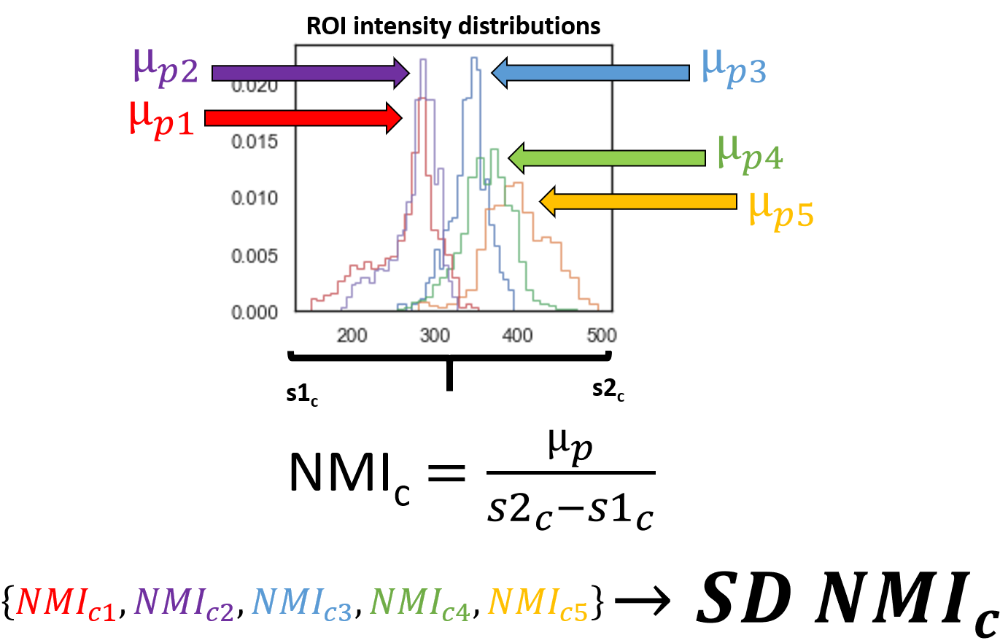
</div>

SD NMIc quantifies ROI histogram overlap. The variability of mean values across various distributions in a cohort calculated on a normalized scale gives a scale-invariant measure of standardization quality. 

In [13]:
def SDNMI_calc(method_list, tuple_list_2, df_image_new, df_mask):
    """
    Calculates SDNMIc for each ROI for each patient in a given cohort. 
        Parameters:
            method_list (lst): List of strings corresponding to which standardization methods should be called.
            tuple_list_2 ((str,int,str)): List of tuples corresponding to pairs of ROI names, ROI indexes, and ROI categories.
            df_image_new (pd dataframe): Dataframe with rows corresponding to np arrays of unique patient method combinations. 
            df_mask (pd dataframe): Dataframe with rows corresponding to unique patients, columns containing np array of mask, patient identifier, and modality.
        Returns:
            df2 (pd dataframe): Dataframe with rows corresponding to SDNMIc scores of unique combinations of ROIs, patients, and standardization methods.
    """
    
    method_list = method_list.copy()
    df2 = pd.DataFrame(columns=['Modality','ROI', 'Method', 'NMI', "SD_NMI", "COV_NMI", "COV_ALL", 'SD_mean_raw'])
    counter = -1  
    
    for method in method_list:
        for tup in tuple_list_2:
            index = tup[0]
            roi = tup[1]
            counter +=1
            NMI_list = [] # used for calculating the SD of the NMI for each region of interest 
            array_list = [] # can iterativley store here 
            mean_list = []
            df_new = df_image_new.loc[df_image_new['Normalization'] == method]
            for modality, MRN, image, mask in zip(df_new['Modality'], df_new['MRN'], df_new['image_array'], df_mask['mask_array']):
                image = image + 10000 # accounting for 0's in CT # dont need for zed score I think?
                mask = convert_array(mask, index)
                mask_superimposed = np.multiply(mask,image)
                mask_superimposed[mask_superimposed==0] = 20000
                mask_superimposed[mask_superimposed!= 20000] -= 10000 # accounting for 0's in CT
                mask_superimposed_no0 = mask_superimposed[mask_superimposed != 20000] # purley for plotting purposes, had to do to plot 0's for CT

                array_list.append(mask_superimposed_no0)
                mean_list.append(np.mean(mask_superimposed_no0))  

            all_arrays = np.concatenate(array_list) # concatenate

            for array in array_list:
                NMI = np.mean(array)/((np.percentile(all_arrays,98))-(np.percentile(all_arrays,2))) 
                NMI_list.append(NMI)

            sd_NMI = np.std(NMI_list) #sd of NMI
            cov_NMI = np.divide(np.std(NMI_list), abs(np.mean(NMI_list))) # coefficient of variation of NMI
            sd_mean = np.std(mean_list)
            cov_all = np.divide(np.std(all_arrays), abs(np.mean(all_arrays))) # coefficient of variation of all histograms

            df2.loc[counter] = [modality, roi, method, NMI_list, sd_NMI, cov_NMI, cov_all, sd_mean] # add to dataframe here
            
    return df2 

In [14]:
def SDNMI_heatmap(method_list, tuple_list_2, df2):
    """
    Generates a heatmap of SDNMIc scores per ROI per standardization method. 
        Parameters:
            method_list (lst): List of strings corresponding to which standardization methods should be called.
            tuple_list_2 ((str,int,str)): List of tuples corresponding to pairs of ROI names, ROI indexes, and ROI categories.
            df2 (pd dataframe): Dataframe with rows corresponding to SDNMIc scores of unique combinations of ROIs, patients, and standardization methods.
        Returns:
            None (generates in-line plot and prints mean ± SD for each method).
    """
    column_list = [tup[1] for tup in tuple_list_2]
    
    method_list = method_list.copy() # to prevent index problems downstream
    method_list.reverse()
    
    fig, ax = plt.subplots(1, 1, figsize =(12,10))

    master_heatmap_df = pd.DataFrame(index = method_list, columns = column_list)

    for method in method_list:
        for roi in column_list: 
            master_heatmap_df.at[method, roi] = df2[(df2['ROI'] == roi) & (df2['Method'] == method)].iloc[0]['SD_NMI']
            master_heatmap_df = master_heatmap_df[master_heatmap_df.columns].astype(float)

    master_heatmap_df['Mean'] = master_heatmap_df.mean(axis=1) # get mean values and place in new heatmap column
    mean_print = master_heatmap_df.mean(axis=1) # get mean values across all ROIs for each method to print
    sd_print = master_heatmap_df.std(axis=1) # get std across all ROIs for each method to print
    print_df = pd.concat([mean_print, sd_print], axis=1).iloc[::-1] # combine mean values with std values         

    heatmap = sns.heatmap(master_heatmap_df, vmin = 0.10, vmax = 0.28, cmap = 'coolwarm', linewidths=0, cbar_kws = dict(pad=0.05, use_gridspec=False,location="bottom", label =  'SD NMIc', format = '%.2f'), annot= True, fmt=".2f") # for NMI
    heatmap.set(xlabel='ROI', ylabel='Intensity Standardization Method', title ='SD NMIc per ROI per Intensity Standardization Method')
    heatmap.invert_yaxis()
    ax.xaxis.tick_top()
    ax.xaxis.set_label_position('top') 
    plt.yticks(rotation=0)
    plt.xticks(rotation=90)

    # find your QuadMesh object and get array of colors
    quadmesh = ax.findobj(QuadMesh)[0]
    facecolors = quadmesh.get_facecolors()

    # make colors of the last (mean) column white, makes displaying results more readable 
    facecolors[np.arange(-1,np.sum(master_heatmap_df.count()),len(master_heatmap_df.columns))] = np.array([1,1,1,1])
    # set modified colors
    quadmesh.set_facecolors = facecolors

    # set color of all text to black
    for i in ax.findobj(Text):
        i.set_color('black')
        
    # print mean ± SD for each method
    for index, row in print_df.iterrows():
        print(index, '%.2f'%row[0], '\u00B1', '%.2f'%row[1])

In [15]:
sns.set(font_scale=1.5) # for plotting 
sns.set_style("white")
plt.rcParams['figure.figsize'] = (6, 4) # default size 
#%config InlineBackend.figure_format = 'retina' # for high quality figure print outs
%config InlineBackend.figure_format = 'jpeg' # for low quality figure print outs

## HET Cohort <a name="HET"></a>
Code takes approx. 5 mins to run.

In [16]:
%%time
%%capture
ROI_list_HET  = ['CSF_inf', 'CSF_mid', 'CSF_sup', 
            'Fat_L', 'Fat_R','NapeFat_inf', 'NapeFat_mid', 'NapeFat_sup','NeckFat',
            'Masseter_L', 'Masseter_R','RCPM',
            'Cerebellum', 
             'Skull',
             'External']  

path_HET = os.path.join('.', 'HET_cohort') # HET Cohort 
path2_HET = os.path.join('.', 'HET_cohort_nyul')

method_list_HET = ['Original', 'MinMax', 'Z-All', 'Z-External', 'Fat', 'Nyul']

tuple_list_HET, fat_left_index_HET, fat_right_index_HET, external_index_HET, df_image_HET, df_mask_HET = dicom_to_numpy(ROI_list_HET, path_HET, "T2")
df_image_new_HET = standardization(method_list_HET, df_image_HET, df_mask_HET, fat_left_index_HET, fat_right_index_HET, external_index_HET, path2_HET)

Wall time: 2min 16s


In [17]:
dicom_HET_T2 = dicom_header_info(path_HET, "T2")
dicom_HET_T2 # display the dataframe 

,SeriesDescription,Manufacturer,ManufacturerModelName,MagneticFieldStrength,RepetitionTime,EchoTime,EchoTrainLength,FlipAngle,PixelSpacing,SliceThickness,SpacingBetweenSlices,ImagingFrequency,NumberOfAverages,PercentSampling,PixelBandwidth,AcquisitionMatrix,PixelRepresentation
0,Ax T2,SIEMENS,Aera,1.5,3020.00,93.000,13,150.0,"[0.703125, 0.703125]",3.0,3.3,63.678384,2.0,80.0,190.000,"[256, 0, 0, 205]",0
1,AX T2,GE MEDICAL SYSTEMS,Signa HDxt,3.0,4283.34,109.872,23,90.0,"[0.4688, 0.4688]",4.0,5.0,127.728790,2.0,100.0,162.773,"[320, 0, 0, 224]",1
2,AX T2 frFSE,GE MEDICAL SYSTEMS,SIGNA EXCITE,1.5,4050.00,88.880,17,90.0,"[0.46875, 0.46875]",5.0,6.0,63.856603,1.5,100.0,122.070,"[0, 256, 224, 0]",1
3,T2W_TSE,Philips Medical Systems,Ingenia,3.0,5690.00,100.000,16,90.0,"[0.5, 0.5]",2.5,2.5,127.770846,2.0,100.0,184.000,"[0, 256, 256, 0]",0
4,Ax 3D T2,GE MEDICAL SYSTEMS,DISCOVERY MR750,3.0,3000.00,98.592,65,90.0,"[0.4297, 0.4297]",2.0,1.0,127.746787,2.0,100.0,195.312,"[0, 320, 256, 0]",1


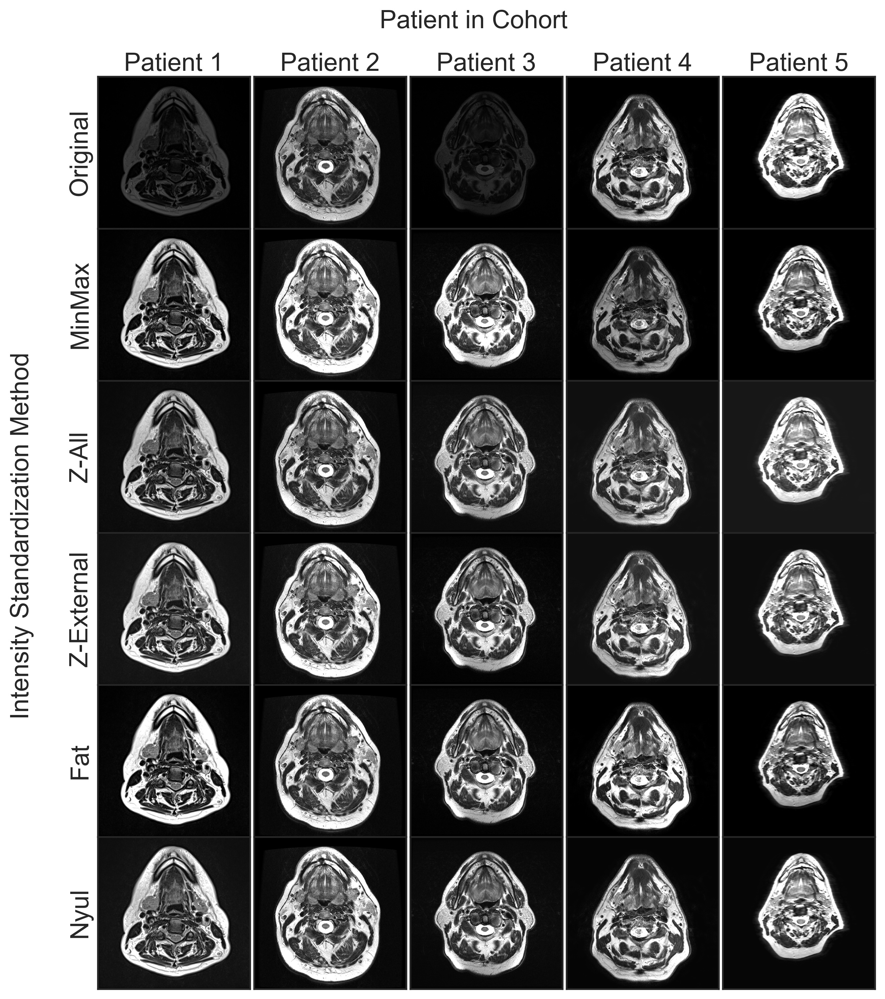

In [18]:
%%time
plot_paper_images(method_list_HET, df_image_new_HET, "HET")

In [19]:
%%time
df_HET = SDNMI_calc(method_list_HET, tuple_list_HET, df_image_new_HET, df_mask_HET)

Wall time: 15.1 s
Wall time: 2min 51s


Original 0.28 ± 0.04
MinMax 0.21 ± 0.04
Z-All 0.18 ± 0.04
Z-External 0.16 ± 0.04
Fat 0.16 ± 0.06
Nyul 0.16 ± 0.04


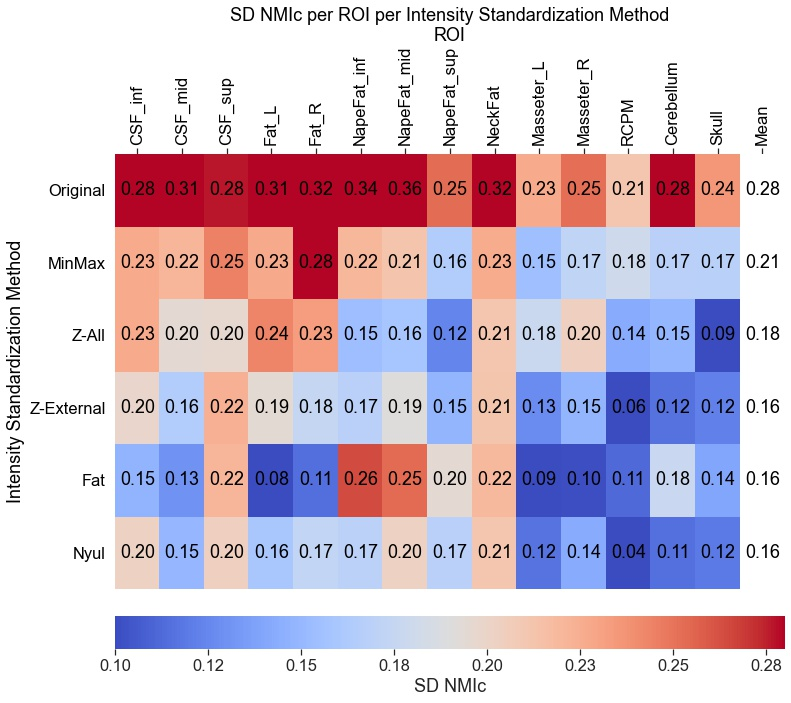

In [20]:
SDNMI_heatmap(method_list_HET, tuple_list_HET, df_HET)

In [21]:
pg.normality(df_HET, dv='SD_NMI', group='Method')

,W,pval,normal
Original,0.966001,0.819133,True
MinMax,0.915520,0.189481,True
Z-All,0.967863,0.846834,True
Z-External,0.957933,0.688957,True
Fat,0.924246,0.252970,True
Nyul,0.914480,0.183022,True


In [22]:
pg.friedman(data=df_HET, dv='SD_NMI', within='Method', subject='ROI')

,Source,ddof1,Q,p-unc
Friedman,Method,5,41.306122,8.137191e-08


In [23]:
pairwise_ttests_HET = pairwise_ttests(data = df_HET, dv = "SD_NMI", subject = "ROI", within = "Method", padjust='bonf', parametric = False) # okay I think this is what you want

In [24]:
pairwise_ttests_HET

,Contrast,A,B,Paired,Parametric,W-val,Tail,p-unc,p-corr,p-adjust,hedges
0,Method,Original,MinMax,True,False,0.0,two-sided,0.000122,0.001831,bonf,1.878443
1,Method,Original,Z-All,True,False,0.0,two-sided,0.000122,0.001831,bonf,2.294630
2,Method,Original,Z-External,True,False,0.0,two-sided,0.000122,0.001831,bonf,2.706122
3,Method,Original,Fat,True,False,0.0,two-sided,0.000122,0.001831,bonf,2.245091
4,Method,Original,Nyul,True,False,0.0,two-sided,0.000122,0.001831,bonf,2.753509
5,Method,MinMax,Z-All,True,False,15.0,two-sided,0.016602,0.249023,bonf,0.613670
6,Method,MinMax,Z-External,True,False,0.0,two-sided,0.000122,0.001831,bonf,1.052530
7,Method,MinMax,Fat,True,False,20.0,two-sided,0.041870,0.628052,bonf,0.852181
8,Method,MinMax,Nyul,True,False,1.0,two-sided,0.000244,0.003662,bonf,1.141558
9,Method,Z-All,Z-External,True,False,26.0,two-sided,0.104004,1.000000,bonf,0.400717


## HOM Cohort <a name="HOM"></a>
Code takes approx. 10 mins to run.

In [25]:
%%time
%%capture
ROI_list_HOM  = ['CSF_inf', 'CSF_mid', 'CSF_sup', 
            'Fat_L', 'Fat_R','NapeFat_inf', 'NapeFat_mid', 'NapeFat_sup','NeckFat',
            'Masseter_L', 'Masseter_R','RCPM',
            'Cerebellum', 
             'Skull',
             'External']  

path_HOM = os.path.join('.', 'HOM_cohort') # HOM cohort
path2_HOM = os.path.join('.', 'HOM_cohort_nyul')

method_list_HOM = ['Original', 'MinMax', 'Z-All', 'Z-External', 'Fat', 'Nyul']

tuple_list_HOM, fat_left_index_HOM, fat_right_index_HOM, external_index_HOM, df_image_HOM, df_mask_HOM = dicom_to_numpy(ROI_list_HOM, path_HOM, "T2")
df_image_new_HOM = standardization(method_list_HOM, df_image_HOM, df_mask_HOM, fat_left_index_HOM, fat_right_index_HOM, external_index_HOM, path2_HOM)

Wall time: 3min 46s


In [26]:
dicom_HOM_T2 = dicom_header_info(path_HOM, "T2")
dicom_HOM_T2 # display the dataframe 

,SeriesDescription,Manufacturer,ManufacturerModelName,MagneticFieldStrength,RepetitionTime,EchoTime,EchoTrainLength,FlipAngle,PixelSpacing,SliceThickness,SpacingBetweenSlices,ImagingFrequency,NumberOfAverages,PercentSampling,PixelBandwidth,AcquisitionMatrix,PixelRepresentation
0,T2 TSE,SIEMENS,Aera,1.5,4800.0,80.0,15,180.0,"[0.5, 0.5]",2.0,2.0,63.675912,1.0,90.0,300.0,"[256, 0, 0, 230]",0
1,T2 TSE,SIEMENS,Aera,1.5,4800.0,80.0,15,180.0,"[0.5, 0.5]",2.0,2.0,63.675952,1.0,90.0,300.0,"[256, 0, 0, 230]",0
2,T2 TSE,SIEMENS,Aera,1.5,4800.0,80.0,15,180.0,"[0.5, 0.5]",2.0,2.0,63.675934,1.0,90.0,300.0,"[256, 0, 0, 230]",0
3,T2 TSE,SIEMENS,Aera,1.5,4800.0,80.0,15,180.0,"[0.5, 0.5]",2.0,2.0,63.675873,1.0,90.0,300.0,"[256, 0, 0, 230]",0
4,T2 TSE,SIEMENS,Aera,1.5,4800.0,80.0,15,180.0,"[0.5, 0.5]",2.0,2.0,63.675945,1.0,90.0,300.0,"[256, 0, 0, 230]",0


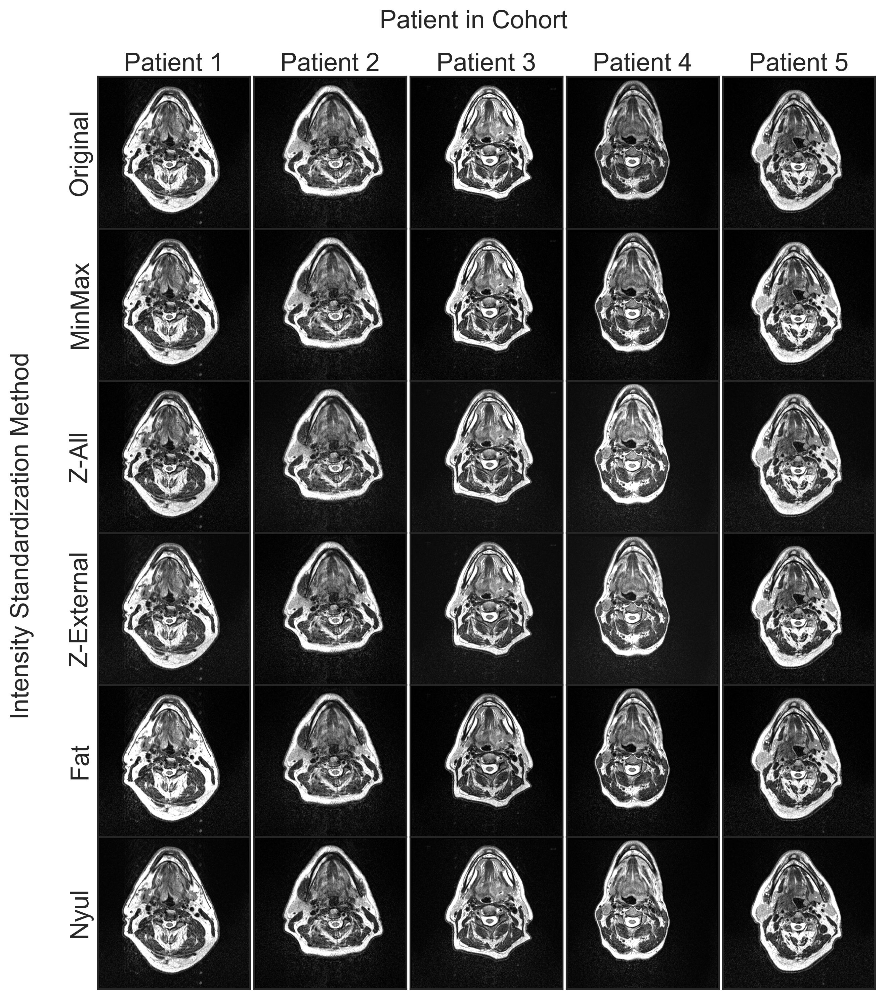

Wall time: 1min 3s


In [27]:
%%time
plot_paper_images(method_list_HOM, df_image_new_HOM, "HOM")

In [28]:
%%time
df_HOM = SDNMI_calc(method_list_HOM, tuple_list_HOM, df_image_new_HOM, df_mask_HOM)

Wall time: 5min 31s


Original 0.15 ± 0.05
MinMax 0.12 ± 0.05
Z-All 0.16 ± 0.03
Z-External 0.14 ± 0.04
Fat 0.13 ± 0.05
Nyul 0.13 ± 0.04


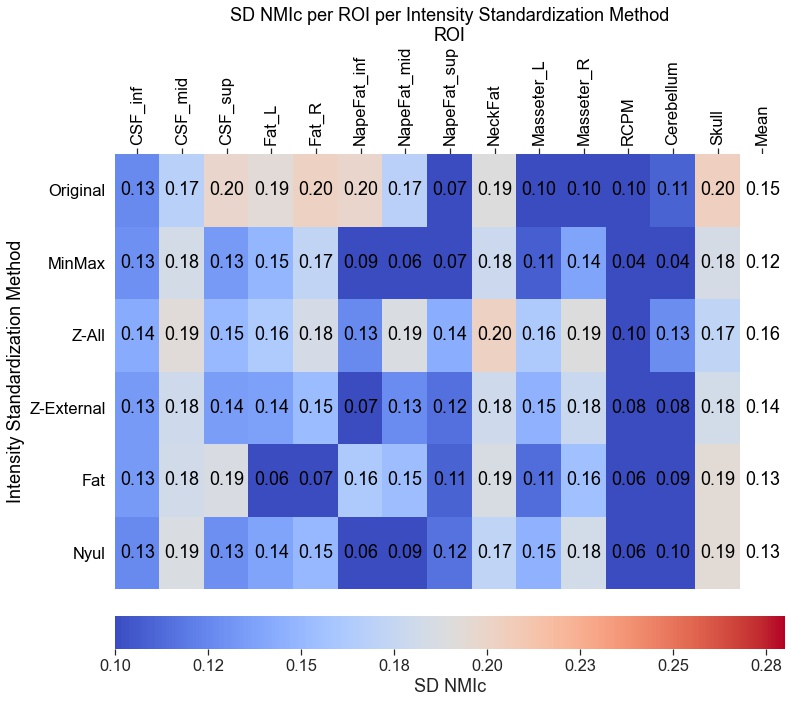

In [29]:
SDNMI_heatmap(method_list_HOM, tuple_list_HOM, df_HOM)

In [30]:
pg.normality(df_HOM, dv='SD_NMI', group='Method') # check for non-normal distributions 

,W,pval,normal
Original,0.855868,0.026708,False
MinMax,0.920728,0.225258,True
Z-All,0.956499,0.665269,True
Z-External,0.902963,0.124529,True
Fat,0.903608,0.127244,True
Nyul,0.948478,0.537342,True


In [31]:
pg.friedman(data=df_HOM, dv='SD_NMI', within='Method', subject='ROI') # non-parametric analog to repeated measures ANOVA

,Source,ddof1,Q,p-unc
Friedman,Method,5,19.183673,0.001776


In [32]:
pairwise_ttests_HOM = pairwise_ttests(data = df_HOM, dv = "SD_NMI", subject = "ROI", within = "Method", padjust='bonf', parametric = False) # okay I think this is what you want

In [33]:
pairwise_ttests_HOM

,Contrast,A,B,Paired,Parametric,W-val,Tail,p-unc,p-corr,p-adjust,hedges
0,Method,Original,MinMax,True,False,19.0,two-sided,0.035278,0.529175,bonf,0.597495
1,Method,Original,Z-All,True,False,45.0,two-sided,0.669800,1.000000,bonf,-0.207817
2,Method,Original,Z-External,True,False,34.0,two-sided,0.267578,1.000000,bonf,0.349202
3,Method,Original,Fat,True,False,37.0,two-sided,0.357544,1.000000,bonf,0.380561
4,Method,Original,Nyul,True,False,32.0,two-sided,0.216553,1.000000,bonf,0.400380
5,Method,MinMax,Z-All,True,False,3.0,two-sided,0.000610,0.009155,bonf,-0.912795
6,Method,MinMax,Z-External,True,False,27.0,two-sided,0.118896,1.000000,bonf,-0.322911
7,Method,MinMax,Fat,True,False,27.0,two-sided,0.118896,1.000000,bonf,-0.228041
8,Method,MinMax,Nyul,True,False,32.0,two-sided,0.216553,1.000000,bonf,-0.243007
9,Method,Z-All,Z-External,True,False,2.0,two-sided,0.000366,0.005493,bonf,0.691327


## P-Value Heatmap <a name="pval"></a>

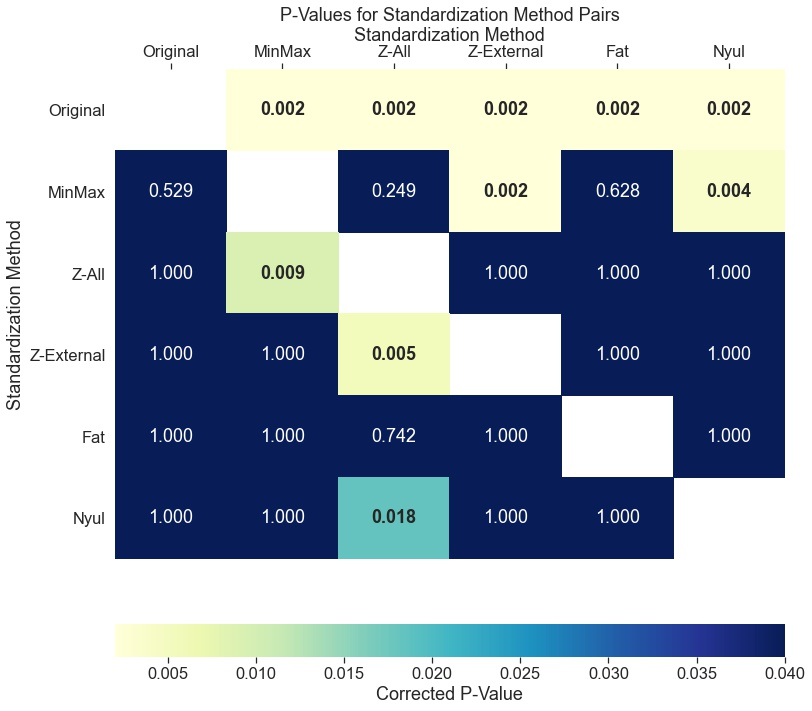

In [34]:
method_list = ['Original','MinMax', 'Z-All', 'Z-External', 'Fat', 'Nyul']

stats_heatmap_df = pd.DataFrame(index = method_list, columns = method_list)

for col in method_list:
    for row in method_list:
        if col == row:
            stats_heatmap_df.at[row, col] = "NaN"
        else:
            try: # error handeling if rows and cols don't match up, due to inherent structure of above 
                p_val = pairwise_ttests_HOM[(pairwise_ttests_HOM['A'] == col) & (pairwise_ttests_HOM['B'] == row)].iloc[0]['p-corr']
            except: 
                p_val = pairwise_ttests_HET[(pairwise_ttests_HET['A'] == row) & (pairwise_ttests_HET['B'] == col)].iloc[0]['p-corr']
            stats_heatmap_df.at[row, col] = p_val
            
stats_heatmap_df = stats_heatmap_df.astype(float)

fig, ax = plt.subplots(1, 1, figsize =(12,12))

heatmap = sns.heatmap(stats_heatmap_df, cmap="YlGnBu", annot= True, fmt=".3f", vmin = 0.002, vmax = 0.04,
                     cbar_kws = dict(pad=0.1, use_gridspec=False,location="bottom", label =  'Corrected P-Value', format = '%.3f'))
heatmap.set(xlabel='Standardization Method', ylabel='Standardization Method', title ='P-Values for Standardization Method Pairs')

for text in heatmap.texts: # make p < 0.05 bold
    try:
        if float(text.get_text()) <= 0.05:
            text.set_weight('bold')
    except:
        continue

ax.xaxis.tick_top()
ax.xaxis.set_label_position('top') 
plt.yticks(rotation=0);
#plt.savefig('p_heatmap_new.svg', bbox_inches='tight') # save vector based for adding borders in Illustrator 

# Supplementary Data <a name="appendix"></a>

In [35]:
sns.set(font_scale=1) # for plotting 
sns.set_style("white")
plt.rcParams['figure.figsize'] = (6, 4) # change back to default size 
#%config InlineBackend.figure_format = 'png' # for medium quality figure print outs
%config InlineBackend.figure_format = 'jpeg' # for low quality figure print outs

## Simulation Studies <a name="sim"></a>

In [36]:
import random 
import warnings 
from scipy.linalg import norm

from scipy.spatial.distance import jensenshannon 
from scipy.special import kl_div 
from scipy.spatial.distance import euclidean
from scipy.stats import wasserstein_distance

import statsmodels.sandbox.distributions.extras as extras
import scipy.interpolate as interpolate

from math import sqrt

In [37]:
def generate_normal_four_moments(mu, sigma, skew, kurt, size=1000, sd_wide = 10): 
    """
    Generate a distribution based on a set of distributional parameters (mean, SD, skew, kurtosis). Adapted from:
    https://gist.github.com/raddy/4084ade3d3a82911d43df9375f9697f4.
        Parameters:
            mu (float): Mean of distribution. 
            sigma (float): Standard deviation of distribution. 
            skew (float): Skew of distribution. 
            kurtosis (float): Kurtosis of distribution. 
            size (int): Number of samples to draw. 
            sd_wide (int): Width edges used as multiplier. 
        Returns:
            distribution (probablity density function): set of random points based on parameters. 
    """
    np.random.seed(1) # set random seed so output is reproducible 
    f = extras.pdf_mvsk([mu, sigma, skew, kurt])
    x = np.linspace(mu - sd_wide * sigma, mu + sd_wide * sigma, num=500)
    y = [f(i) for i in x]
    yy = np.cumsum(y) / np.sum(y)
    inv_cdf = interpolate.interp1d(yy, x, fill_value="extrapolate")
    rr = np.random.rand(size)
    distribution = inv_cdf(rr)
    return distribution

In [38]:
"credit for following functions: https://gist.github.com/larsmans/3116927"

_SQRT2 = np.sqrt(2)  # sqrt(2) with default precision np.float64

def hellinger1(p, q):
    return norm(np.sqrt(p) - np.sqrt(q)) / _SQRT2

def hellinger2(p, q):
    return euclidean(np.sqrt(p), np.sqrt(q)) / _SQRT2

def hellinger3(p, q):
    return np.sqrt(np.sum((np.sqrt(p) - np.sqrt(q)) ** 2)) / _SQRT2

In [39]:
def pairwise_metric(fnc, histograms): 
    """
    Creates pairwise caluclatinos for a given metric. Reduces down to the original metric in the case of 2 distributions. 
        Parameters:
            fnc (function): A function for calculating a metric between two histograms, i.e. SD NMIc, Jenson Shannon Divergence, etc. 
            histograms (lst): List of np arrays corresponding to histograms. 
        Returns:
            pw_metric (float): Value corresponding to the mean of the pairwise calculations. 
    """
    pairwise_metric_list = []
    for i in range(len(histograms)):
        for j in range(i + 1, len(histograms)):
            pairwise_metric_list.append(fnc(histograms[i], histograms[j]))
    pw_metric = np.mean(pairwise_metric_list)
    return pw_metric 

In [40]:
"credit for following function: https://stackoverflow.com/questions/26785354/normalizing-a-list-of-numbers-in-python"

def normalize(lst):
    return [float(i)/sum(lst) for i in lst]

### S1c, S2c determination <a name="sim1"></a>

In [41]:
%%time

mean_range_list = []
leftmost_percentage_list = []

for tup in tuple_list_HET:
    #print(tup) # uncomment to determine which ROI gives max values
    index = tup[0]
    roi = tup[1]
    array_list = [] # can iterativley store here 
    mean_list = []
    df_new = df_image_new_HET.loc[df_image_new_HET['Normalization'] == "Original"]
    for modality, MRN, image, mask in zip(df_new['Modality'], df_new['MRN'], df_new['image_array'], df_mask_HET['mask_array']):
        image = image + 10000 # accounting for 0's in CT 
        mask = convert_array(mask, index)
        mask_superimposed = np.multiply(mask,image)
        mask_superimposed[mask_superimposed==0] = 20000
        mask_superimposed[mask_superimposed!= 20000] -= 10000 # accounting for 0's in CT
        mask_superimposed_no0 = mask_superimposed[mask_superimposed != 20000] # purley for plotting purposes, had to do to plot 0's for CT

        array_list.append(mask_superimposed_no0)
        mean_list.append(np.mean(mask_superimposed_no0))
    
    maximum = max(mean_list)
    minimum = min(mean_list)
    mean_range = maximum - minimum # this is the range for ROI 
    #print(mean_range) # uncomment to determine which ROI gives max range
    mean_range_list.append(mean_range)
    
    all_arrays = np.concatenate(array_list) # concatenate
    
    leftmost_percentage = np.count_nonzero((all_arrays < maximum))/all_arrays.size  
    #print(leftmost_percentage) # uncomment to determine which ROI gives max leftmost_percentage
    
    leftmost_percentage_list.append(leftmost_percentage)

max_mean_range = max(mean_range_list)
max_leftmost_percentage = max(leftmost_percentage_list)

Wall time: 20.7 s


In [42]:
print(max_mean_range)
print(max_leftmost_percentage)

3199.136719466678
0.9675432501501536


In [43]:
%%time
warnings.filterwarnings('ignore') # ignore depreciation warnings

num_patients = 100
size = 100
nbins = 20 # JSD doesnt compute correctly if 0's in bins 

df_PCA = pd.DataFrame(columns=['Iteration', 'percent_outlier', 'push_factor', 'SD_NMI', 'SD_Mean', 'JSD', "Wasserstein", "KLD", "Hellinger"]) # for scipy 

scale = 1

sd_NMI_list = []
sd_mean_list = []
jsd_d_list = []
w_d_list = []
kl_d_list = []
h_d_list = []

percent_list = [0, 0.01, 0.02, 0.03, 0.04, 0.05, 0.06, 0.07, 0.08, 0.09, 0.1, 0.2, 0.3, 0.4, 0.5]

push_factor_list = [max_mean_range] # really the only important one 

for push_factor in push_factor_list:
    for percent in percent_list:
        outliers = int(num_patients*percent)
        new_patient_number = (num_patients - outliers)
        
        random.seed(1) # need to set before, random seeds in function take over after first iteration 
        cohort = [generate_normal_four_moments(random.random(),1,0,0, size = size) for i in range(new_patient_number)] # list of arrays
        
        if percent != 0:
            cohort_outliers = [generate_normal_four_moments(random.random()+push_factor,1,0,0, size = size) for i in range(outliers)] # list of arrays
            cohort = cohort + cohort_outliers

        histograms = [np.histogram(patient.flatten(), nbins, range= (np.amin(patient), np.amax(patient)), density=True)[0] for patient in cohort]
        histograms = [(histogram+0.005)/np.linalg.norm(histogram+0.005) for histogram in histograms] # laplace correction https://stats.stackexchange.com/questions/14127/how-to-compute-the-kullback-leibler-divergence-when-the-pmf-contains-0s

        mean_list = [np.mean(patient) for patient in cohort]
        sd_mean = np.std(mean_list) 
        sd_mean_list.append(sd_mean)

        all_arrays = np.concatenate(cohort) # concatenate
        NMI_list = [np.mean(array)/((np.percentile(all_arrays,95))-(np.percentile(all_arrays,5))) for array in cohort]
        sd_NMI = np.std(NMI_list)
        sd_NMI_list.append(sd_NMI)

        jsd_d, w_d, kl_d, h_d = map(pairwise_metric, [jensenshannon, wasserstein_distance, kl_div, hellinger3], [histograms]*4) 

        df_PCA.loc[scale] = [scale, percent, push_factor, sd_NMI, sd_mean, jsd_d, w_d, kl_d, h_d] 

        scale +=1

Wall time: 24.1 s


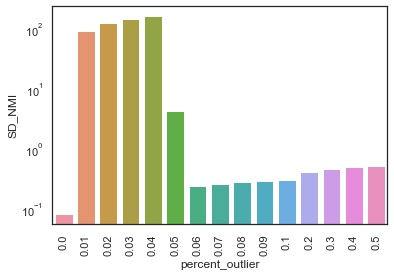

In [44]:
ax = sns.barplot(x='percent_outlier', y = 'SD_NMI', data = df_PCA)
ax.set_yscale("log")
ax.set_xticklabels(ax.get_xticklabels(), rotation=90); # ; supresses output of object for better plotting

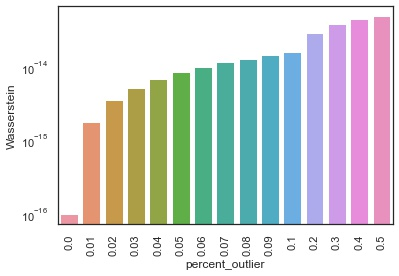

In [45]:
ax = sns.barplot(x='percent_outlier', y = 'Wasserstein', data = df_PCA) # Wasserstein and Hellinger act exactly the same 
ax.set_yscale("log")
ax.set_xticklabels(ax.get_xticklabels(), rotation=90); # ; supresses output of object for better plotting

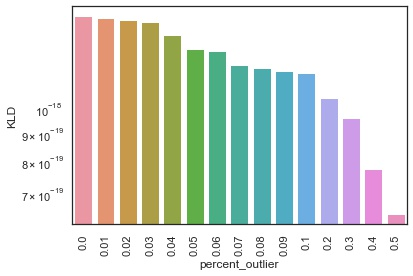

In [46]:
ax = sns.barplot(x='percent_outlier', y = 'KLD', data = df_PCA) # KLD works but JSD returns nans/inf for large push
ax.set_yscale("log")
ax.set_ylabel("KLD")
ax.set_xticklabels(ax.get_xticklabels(), rotation=90); 

### Scale Invariance <a name="sim2"></a>

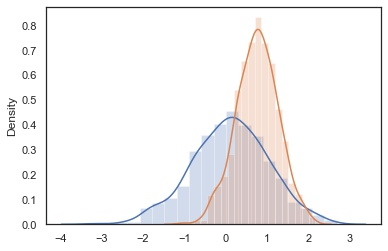

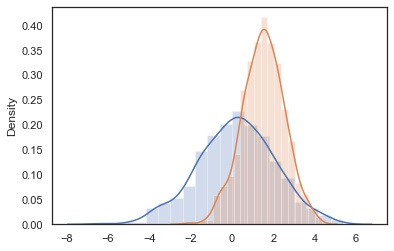

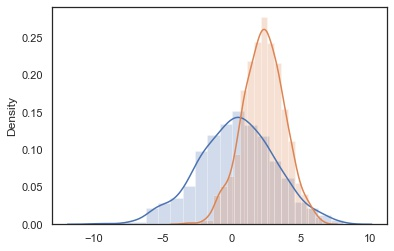

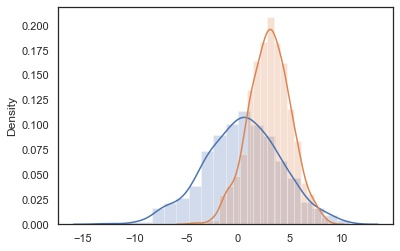

In [47]:
warnings.filterwarnings('ignore') # ignore depreciation warnings

num_patients = 2
size = 1000
nbins = 20 # JSD doesnt compute correctly if 0's in bins

empty_list = []
scale = 1

sd_NMI_list = []
sd_mean_list = []
jsd_d_list = []
w_d_list = []
kl_d_list = []
h_d_list = []

scale_list = []

while scale < 5:
    random.seed(1) 
    cohort = [generate_normal_four_moments(random.random(),random.random(),0,0, size = size) * scale for i in range(num_patients)] # list of arrays
    
    histograms = [np.histogram(patient.flatten(), nbins, range= (np.amin(patient), np.amax(patient)), density=True)[0] for patient in cohort]
    histograms = [(histogram+0.005)/np.linalg.norm(histogram+0.005) for histogram in histograms] # laplace correction https://stats.stackexchange.com/questions/14127/how-to-compute-the-kullback-leibler-divergence-when-the-pmf-contains-0s
    
    mean_list = [np.mean(patient) for patient in cohort]
    sd_mean = np.std(mean_list) 
    sd_mean_list.append(sd_mean)
    
    all_arrays = np.concatenate(cohort) # concatenate
    NMI_list = [np.mean(array)/((np.percentile(all_arrays,98))-(np.percentile(all_arrays,2))) for array in cohort]
    sd_NMI = np.std(NMI_list)
    sd_NMI_list.append(sd_NMI)

    jsd_d, w_d, kl_d, h_d = map(pairwise_metric, [jensenshannon, wasserstein_distance, kl_div, hellinger3], [histograms]*4) 


    for metric_list, pw_metric in zip([jsd_d_list, w_d_list, kl_d_list, h_d_list], [jsd_d, w_d, kl_d, h_d]): 
        metric_list.append(abs(pw_metric)) # take absolute value 

    [sns.distplot(patient, bins = nbins, hist_kws={'alpha':0.25}) for patient in cohort] # depreciation warning, not sure how to update while keeping the seaborn formatting on same axis 
    plt.show()
    
    scale_list.append(scale)
    scale +=1

master_list = [sd_NMI_list, sd_mean_list, jsd_d_list, w_d_list, kl_d_list, h_d_list]

sd_NMI_list_norm, sd_mean_list_norm, jsd_d_list_norm, w_d_list_norm, kl_d_list_norm, h_d_list_norm = [normalize(lst) for lst in master_list]
master_list_norm = [sd_NMI_list_norm, sd_mean_list_norm, jsd_d_list_norm, w_d_list_norm, kl_d_list_norm, h_d_list_norm]

In [48]:
def plot_metrics(scale_list, metric_list, label_list):
    """
    Plots metric values vs. scale factor. 
        Parameters:
            scale_list (lst): List of values corressponding to scale factor.
            metric_list (lst): List of values corresponding to metric calculatinos.
            label_list (lst): List of strings corresponding to metric labels.  
        Returns:
            None (plots in-line graphs). 
    """
    for lst, label in zip(metric_list, label_list):
        plt.plot(scale_list, lst, label = label)
    plt.xlabel('Scale factor')
    plt.ylabel('Raw metric value')
    plt.legend()

In [49]:
label_list = ['SD_NMI', 'SD_mean', 'JSD', 'Wasserstein', 'KLD', 'Hellinger']

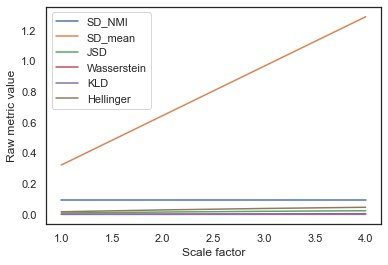

In [50]:
plot_metrics(scale_list, master_list, label_list)

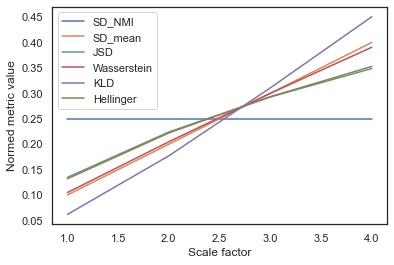

In [51]:
plot_metrics(scale_list, master_list_norm, label_list)
plt.ylabel('Normed metric value');

In [52]:
def generate_dispersion_measures(num_patients, scale):
    """
    Randomly selects distributional parameters for calculations
        Parameters:
            num_patients (int): Number of patient simulations to run. 
            scale (int): Starting value of simulation iteration. 
        Returns:
            means (lst): List of floats corresponding to mean value for each patient. 
            SDs (lst): List of floats corresponding to standard deviation value for each patient.
            skews (lst): List of floats corresponding to skew value for each patient.
            kurts (lst): List of floats corresponding to kurtosis value for each patient.
            factor1s (lst): List of floats corresponding to multipliciative factor (-1 or 1) for corresponding mean value.
            factor2s (lst): List of floats corresponding to multipliciative factor (-1 or 1) for corresponding skew value.
            factor3s (lst): List of floats corresponding to multipliciative factor (-1 or 1) for corresponding kurtosis value.
    """
    means = []
    SDs = []
    skews = []
    kurts = []
    factor1s = []
    factor2s = []
    factor3s = []
    counter = -1
    for i in range(num_patients):
        mean = random.random()
        means.append(mean)
        random.seed(scale+counter+1) 
        SD = random.random()
        SDs.append(SD)
        random.seed(scale+counter+2) 
        skew = random.random()
        skews.append(skew)
        random.seed(scale+counter+3) 
        kurtosis = random.random()
        kurts.append(kurtosis)
        random.seed(scale+counter+4) 
        factor1 = [-1,1][random.randrange(2)] # for randomly setting positive or negative numbers below
        factor1s.append(factor1)
        random.seed(scale+counter+5) 
        factor2 = [-1,1][random.randrange(2)]
        factor2s.append(factor2)
        random.seed(scale+counter+6) 
        factor3 = [-1,1][random.randrange(2)]
        factor3s.append(factor3)
        random.seed(scale+counter+7) 
        counter+=1 
    return means, SDs, skews, kurts, factor1s, factor2s, factor3s

def pw_mean_dispersion_measure(measure_list):
    """
    Calculate mean value for a series of pairwise calculations for distributional parameters. 
        Parameters:
            measure_list (lst): List of lists corresponding to distributinoal parameter for the patients in the simulation, e.g. means calcualted for all patients. 
        Returns:
            pw_mean_dispersion (float): Mean value for that distributional parameter across all patients. 
    """
    pairwise_measure = []
    for i in range(len(measure_list)):
        for j in range(i + 1, len(measure_list)):
            pairwise_measure.append(abs(measure_list[i] - measure_list[j]))
    pw_mean_dispersion = np.mean(pairwise_measure)
    return pw_mean_dispersion

### Properties <a name="sim3"></a>

In [53]:
%%time
%xmode Verbose
# for important one 
warnings.filterwarnings('ignore')

num_patients = 5
size = 100
nbins = 20 # JSD doesnt compute correctly if 0's in bins

df_PCA = pd.DataFrame(columns=['Iteration', 'Mean', 'SD', 'Skew', 'Kurtosis', 'SD_NMI', 'SD_Mean', 'JSD', "Wasserstein", "KLD", "Hellinger"]) # scipy real  

scale = 1

sd_NMI_list = []
sd_mean_list = []
jsd_d_list = []
w_d_list = []
kl_d_list = []
h_d_list = []

scale_list = []

random.seed(1) # need to set before, random seeds in function take over after first iteration 

while scale < 1000:

    means, SDs, skews, kurts, factor1s, factor2s, factor3s = generate_dispersion_measures(num_patients, scale)
    
    cohort = [generate_normal_four_moments(mean*factor1,SD,skew*factor2,kurt*factor3, size = size) for 
              mean, SD, skew, kurt, factor1, factor2, factor3 in zip(means, SDs, skews, kurts, factor1s, factor2s, factor3s)] # list of arrays
    
    histograms = [np.histogram(patient.flatten(), nbins, range= (np.amin(patient), np.amax(patient)), density=True)[0] for patient in cohort]
    histograms = [(histogram+0.005)/np.linalg.norm(histogram+0.005) for histogram in histograms] # laplace correction https://stats.stackexchange.com/questions/14127/how-to-compute-the-kullback-leibler-divergence-when-the-pmf-contains-0s
    
    pw_means, pw_SDs, pw_skews, pw_kurts = map(pw_mean_dispersion_measure, [means,SDs,skews,kurts])
    
    mean_list = [np.mean(patient) for patient in cohort]
    sd_mean = np.std(mean_list) 
    sd_mean_list.append(sd_mean)
    
    all_arrays = np.concatenate(cohort) # concatenate
    NMI_list = [np.mean(array)/((np.percentile(all_arrays,98))-(np.percentile(all_arrays,2))) for array in cohort]
    sd_NMI = np.std(NMI_list)
    sd_NMI_list.append(sd_NMI)
    
    jsd_d, w_d, kl_d, h_d = map(pairwise_metric, [jensenshannon, wasserstein_distance, kl_div, hellinger3], [histograms]*4)   
    
    for metric_list, pw_metric in zip([jsd_d_list, w_d_list, kl_d_list, h_d_list], [jsd_d, w_d, kl_d, h_d]):
        metric_list.append(abs(pw_metric)) # take absolute value 
    
    scale_list.append(scale)
    
    df_PCA.loc[scale] = [scale, pw_means, pw_SDs, pw_skews, pw_kurts, sd_NMI, sd_mean, jsd_d, w_d, kl_d, h_d] 
    
    scale +=1

master_list = [sd_NMI_list, sd_mean_list, jsd_d_list, w_d_list, kl_d_list, h_d_list]

sd_NMI_list_norm, sd_mean_list_norm, jsd_d_list_norm, w_d_list_norm, kl_d_list_norm, h_d_list_norm = [normalize(lst) for lst in master_list]
master_list_norm = [sd_NMI_list_norm, sd_mean_list_norm, jsd_d_list_norm, w_d_list_norm, kl_d_list_norm, h_d_list_norm]

Exception reporting mode: Verbose
Wall time: 1min 5s


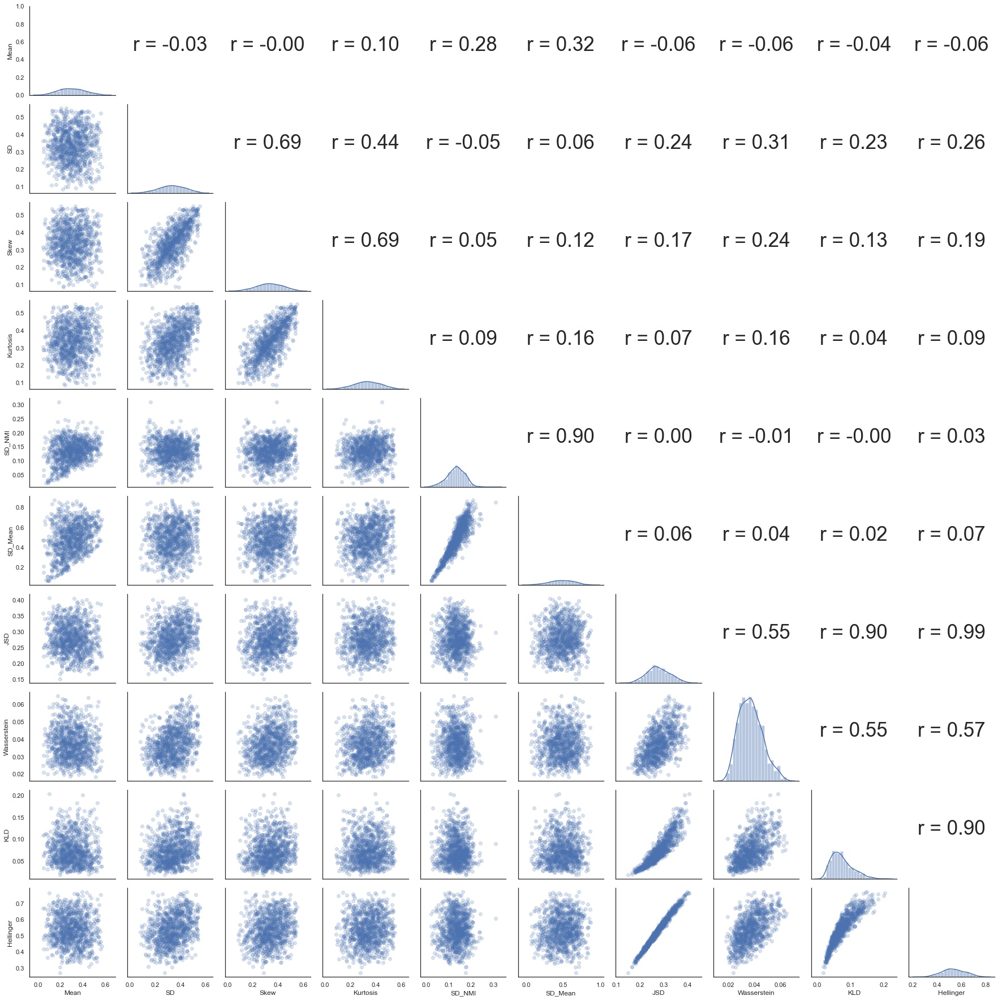

In [54]:
"credit for following function: https://stackoverflow.com/questions/63416894/correlation-values-in-pairplot"
from scipy.stats import pearsonr 
def reg_coef(x,y,label=None,color=None,**kwargs):
    ax = plt.gca()
    r,p = pearsonr(x,y)
    ax.annotate('r = {:.2f}'.format(r), xy=(0.5,0.5), xycoords='axes fraction', ha='center', fontsize=35)
    ax.set_axis_off()

g = sns.PairGrid(df_PCA.loc[:, df_PCA.columns != 'Iteration'])
g.map_diag(sns.distplot)
g.map_lower(plt.scatter, alpha=0.2)
g.map_upper(reg_coef);

## External Mask Approximation <a name="approx"></a>  
Takes approx. 10 mins to run.

In [55]:
%%time
%%capture
df = pd.DataFrame(columns=['MRN', 'Slice', 'Mean', 'Method'])
counter = -1
mean_list = [] # for concatenation 
methods = ['All_voxels', '>30', 'External']

for method in methods:
    for root, dirs, files in os.walk(HOM_cohort_path):
        for d in dirs: # look for the dirs, labeled with modality 
            if d.startswith('T2'): # only considering T2 images in HOM Cohort 
                patient_path = os.path.join(root + '\\'+ d) # path to modality for a given patient 

                Dicom_reader = DicomReaderWriter(description='Examples', series_instances_dictionary = {})
                Dicom_reader.walk_through_folders(patient_path)
                Dicom_reader.set_contour_names_and_associations(Contour_Names=['External_KW'])
                Dicom_reader.get_images_and_mask()
                image = Dicom_reader.ArrayDicom # image array
                external = Dicom_reader.mask  
                external_superimposed = np.multiply(external,image) # external mask

                for i in range(0,120): # iterate through all 120 slices 
                    counter+=1
                    if method == "All_voxels":
                        image_slice = image[i]
                    elif method == ">30":
                        image_slice = image[i]
                        image_slice = image_slice[image_slice>=30]
                    elif method == "External":
                        external_superimposed = np.multiply(external,image)
                        image_slice = external_superimposed[i]
                        image_slice = image_slice[image_slice>=1]

                    mean_slice = np.nanmean(image_slice) # calculate mean per slice 
                    MRN = patient_path.split('\\')[-2] # had to add space for seaborn lineplot to work
                    df.loc[counter] = ["Patient " +str(MRN), i, mean_slice, method]

Wall time: 9min 20s


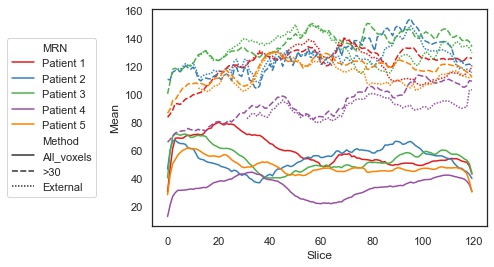

In [56]:
g = sns.lineplot(x="Slice", y="Mean", data=df, hue='MRN', palette=sns.color_palette("Set1", 5), style='Method')
g.legend(loc='center left', bbox_to_anchor=(-.45, 0.5), ncol=1)

## Additional Functions <a name="functions2"></a>

In [57]:
def plot_histograms(method_list, tuple_list_2, df_image_new, df_mask):
    """
    Generate plots of ROI intensity histograms for all patients in a given cohort stratified by tissue type.  
        Parameters:
            method_list (lst): List of strings corresponding to which standardization methods should be called.
            tuple_list_2 ((str,int,str)): List of tuples corresponding to pairs of ROI names, ROI indexes, and ROI categories.
            df_image_new (pd dataframe): Dataframe with rows corresponding to np arrays of unique patient method combinations. 
            df_mask (pd dataframe): Dataframe with rows corresponding to unique patients, columns containing np array of mask, patient identifier, and modality. 
        Returns:
            None (generates in-line plots). 
    """
    method_list = method_list.copy()
    tissue_list = sorted(list(set([tuple[2] for tuple in tuple_list_2])))
    for tissue in tissue_list:
        counter_ROI = -1
        fig, ax = plt.subplots(nrows=len([tup for tup in tuple_list_2 if tup[2] == tissue]), ncols=len(method_list), squeeze=False, figsize=(20,10)) 
        plt.subplots_adjust(wspace=0.3, hspace=0.6)
        for tup in tuple_list_2:
            if tup[2] == tissue:
                counter_ROI +=1
                counter_method = -1
                index = tup[0]
                roi = tup[1]
                for method in method_list:
                    counter_method+=1
                    df_new = df_image_new.loc[df_image_new['Normalization'] == method]
                    for modality, MRN, image, mask in zip(df_new['Modality'], df_new['MRN'], df_new['image_array'], df_mask['mask_array']):
                        image = image + 10000 # accounting for 0's in CT # dont need for zed score I think?
                        mask = convert_array(mask, index)
                        mask_superimposed = np.multiply(mask,image)
                        mask_superimposed[mask_superimposed==0] = 20000
                        mask_superimposed[mask_superimposed!= 20000] -= 10000 # accounting for 0's in CT
                        mask_superimposed_no0 = mask_superimposed[mask_superimposed != 20000] # purley for plotting purposes, had to do to plot 0's for CT
                        ax[counter_ROI][counter_method].hist(mask_superimposed_no0.flatten(), bins = 25, density = True, alpha = 0.75, log = False, histtype= 'step', label = MRN) 
                        ax[counter_ROI][counter_method].set_title(method + ' ' + modality +' ' + roi)

            else:
                continue
        plt.suptitle(tissue)
        plt.show()

In [58]:
def plot_all_images(method_list, df_image_new):
    """
    Generate plots of image slices across z-axis for each patient for each itensity standardization method. 
        Parameters:
            method_list (lst): List of strings corresponding to which standardization methods should be called.
            df_image_new (pd dataframe): Dataframe with rows corresponding to np arrays of unique patient method combinations.  
        Returns:
            None (generates in-line plots). 
    """
    method_list = method_list.copy()
    for method in method_list:
        df_new = df_image_new.loc[df_image_new['Normalization'] == method]
        image_list = [image for image in df_new['image_array']]
        image_list_flatten = [image.flatten() for image in image_list]
        all_images = np.concatenate(image_list_flatten)
        all_min = np.amin(all_images)
        all_max = np.amax(all_images)
        all_max_percentile = np.percentile(all_images,98)
        fig, ax = plt.subplots(5,13, figsize=[24,12], dpi=100, gridspec_kw = {'wspace':0, 'hspace':0})
        counter = -1
        for image in image_list:
            counter+=1
            image = np.moveaxis(image,0,-1)
            n = 0
            slice = 0
            total_slices = image.shape[2]
            for _ in range(13):
                ax[counter][n].imshow(image[:,:,floor(slice)], 'gray', vmin = all_min, vmax = all_max_percentile) 
                ax[counter][n].set_xticks([])
                ax[counter][n].set_yticks([])
                ax[counter][n].set_title("Slice: {}".format(floor(slice)), color = 'r') 
                ax[counter][n].set_aspect("equal")
                if n == 0:
                    ax[counter][n].set_ylabel("Patient " +str(counter+1)) 
                n+=1
                if n == 12: # neccessary to get the last slice for 120 slices
                    slice+=(total_slices/12)-1
                else:
                    slice+=(total_slices/12) 
                fig.subplots_adjust(wspace=0, hspace=0)
        fig.suptitle(method)
        plt.show()

In [59]:
def radiomic(method_list, tuple_list_2, df_image_new, df_mask): 
    """
    Calculates radiomic features per ROI for each patient in a given cohort across all intensity standardization methods. 
        Parameters:
            method_list (lst): List of strings corresponding to which standardization methods should be called.
            tuple_list_2 ((str,int,str)): List of tuples corresponding to pairs of ROI names, ROI indexes, and ROI categories.
            df_image_new (pd dataframe): Dataframe with rows corresponding to np arrays of unique patient and standardization method combinations. 
            df_mask (pd dataframe): Dataframe with rows corresponding to unique patients, columns containing np array of mask, patient identifier, and modality. 
        Returns:
            radiomics_df (pd dataframe): Dataframe with rows corresponding to radiomic feature values of unique combinations of ROIs, patients, and standardization methods.
    """
    method_list = method_list.copy()
    OUTput_files = pd.DataFrame() # make an empty datafram
    
    for method in method_list:
        for tup in tuple_list_2:
            index = tup[0]
            roi = tup[1]
            df_new = df_image_new.loc[df_image_new['Normalization'] == method]

            for modality, MRN, image, mask in zip(df_new['Modality'], df_new['MRN'], df_new['image_array'], df_mask['mask_array']):
                mask = convert_array(mask, index)

                sitk_img = sitk.GetImageFromArray(image) # need sitk image to plug in to Pyradiomics
                sitk_mask = sitk.GetImageFromArray(mask) 

                params = {} # can edit in more params as neccessary 
                params['binCount'] = 32 # based on Carre et al. 2020
                extractor = featureextractor.RadiomicsFeatureExtractor(**params) # instantiate extractor with parameters 
                extractor.disableAllFeatures() # in case where only want some features, can delete these lines if you want deafult
                extractor.enableFeatureClassByName('firstorder') 
                extractor.enableFeatureClassByName('glcm') 
                extractor.enableFeatureClassByName('gldm') 
                extractor.enableFeatureClassByName('glrlm') 
                extractor.enableFeatureClassByName('glszm') 
                extractor.enableFeatureClassByName('ngtdm') 
                features = {} # empty dictionary 
                features = extractor.execute(sitk_img, sitk_mask) #unpack results into features dictionary
                df = pd.DataFrame({k: [v] for k, v in features.items()}) # put dictionary into a dataframe 
                df['MRN'] = MRN
                df['ROI'] = roi
                df['Method'] = method 

                OUTput_files = OUTput_files.append(df, ignore_index = True) # iterativley add the dataframes for each entry together
            
    cols = [c for c in OUTput_files.columns if "diagnostics_" not in c] # get rid on nonessential columns 
    radiomics_df = OUTput_files[cols]

    cols=[i for i in radiomics_df.columns if i not in ["MRN", "ROI", "Method"]] # change all to floats 
    
    for col in cols:
        radiomics_df[col]=radiomics_df[col].astype(float)
    
    return radiomics_df

In [60]:
def f(row): # helper function for recategorizing pandas columns based on stratification criteria 
    if row['ICC2'] < 0.5 :
        val = 'Poor'
    elif row['ICC2'] >= 0.5 and row['ICC2'] < 0.75:
        val = 'Moderate'
    elif row['ICC2'] >= 0.75 and row['ICC2'] < 0.9:
        val = 'Good'
    elif row['ICC2'] >= 0.9:
        val = 'Excellent'
    return val

def plot_radiomic_ICC(method_list, radiomics_df):
    """
    Calculates ICC values on per radiomic feature basis for each standardization method, places in a dataframe, and plots values per feature category.  
        Parameters:
            method_list (lst): List of strings corresponding to which standardization methods should be called.
            radiomics_df (pd dataframe): Dataframe with rows corresponding to radiomic feature values of unique combinations of ROIs, patients, and standardization methods.
        Returns:
            None (generates in-line plots). 
    """
    method_list = method_list.copy()
    df_ICC = pd.DataFrame() # make an empty dataframe 
    
    cols=[i for i in radiomics_df.columns if i not in ["MRN", "ROI", "Method"]]
    
    for method in method_list:
        for col in cols:
            radiomics_df_method = radiomics_df.loc[radiomics_df['Method'] == method]
            icc_table = pg.intraclass_corr(data=radiomics_df_method, targets='ROI', raters='MRN', ratings=col)
            icc1 = icc_table.iat[0,2]
            icc2 = icc_table.iat[1,2]
            icc3 = icc_table.iat[2,2]
            icc1k = icc_table.iat[3,2]
            icc2k = icc_table.iat[4,2]
            icc3k = icc_table.iat[5,2]
            feature_name = col.split("_")[2]
            feature_class = col.split("_")[1]
            df = pd.DataFrame([[method, feature_name, feature_class, icc1, icc2, icc3, icc1k, icc2k, icc3k]], columns = ['Method', 'Feature', 'Class', 'ICC1', 'ICC2', 'ICC3', 'ICC1k', 'ICC2k', 'ICC3k'])
            df_ICC = df_ICC.append(df, ignore_index = True) # iterativley add the dataframes for each entry together 
    
    df_ICC['Reliability'] = df_ICC.apply(f, axis=1)

    ax = sns.catplot(x="Method", hue="Reliability", col = "Class", 
                     data=df_ICC, kind ="count", order = ['Original', 'MinMax', 'Z-All', 'Z-External', 'Fat', 'Nyul'], 
                     hue_order = ['Poor', 'Moderate', 'Good', 'Excellent'], col_wrap=2, sharey=False, sharex = False)

## Complete T2-w data (histograms, images, radiomics) <a name="T2"></a>

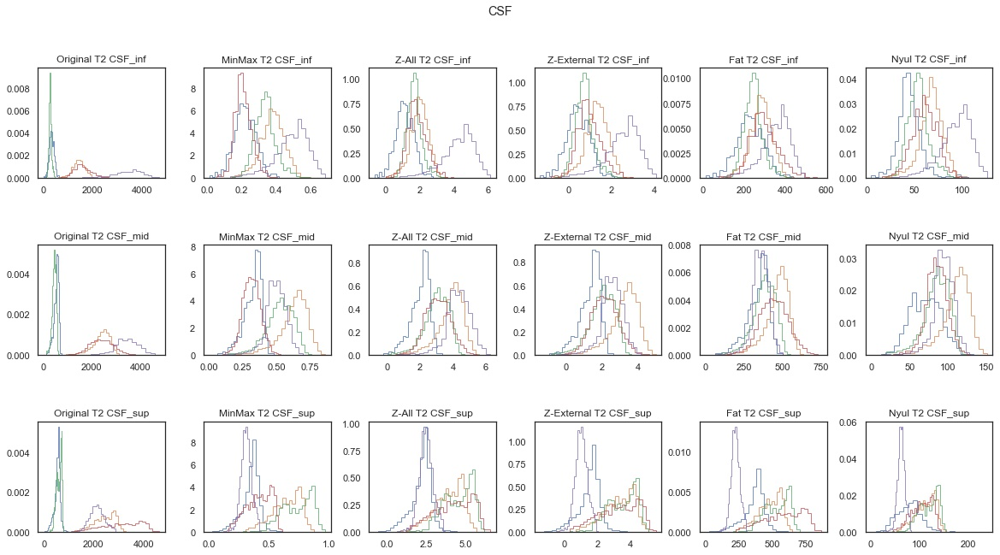

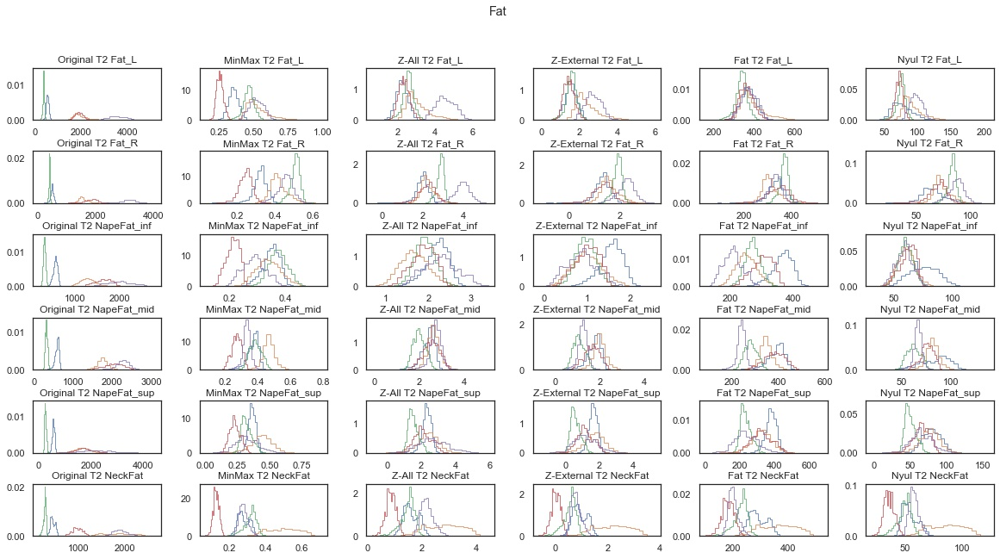

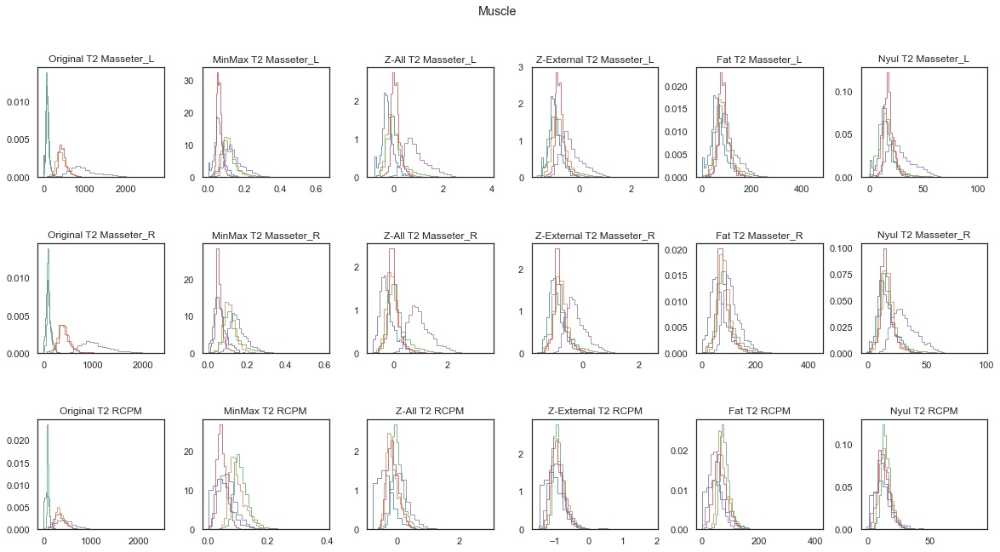

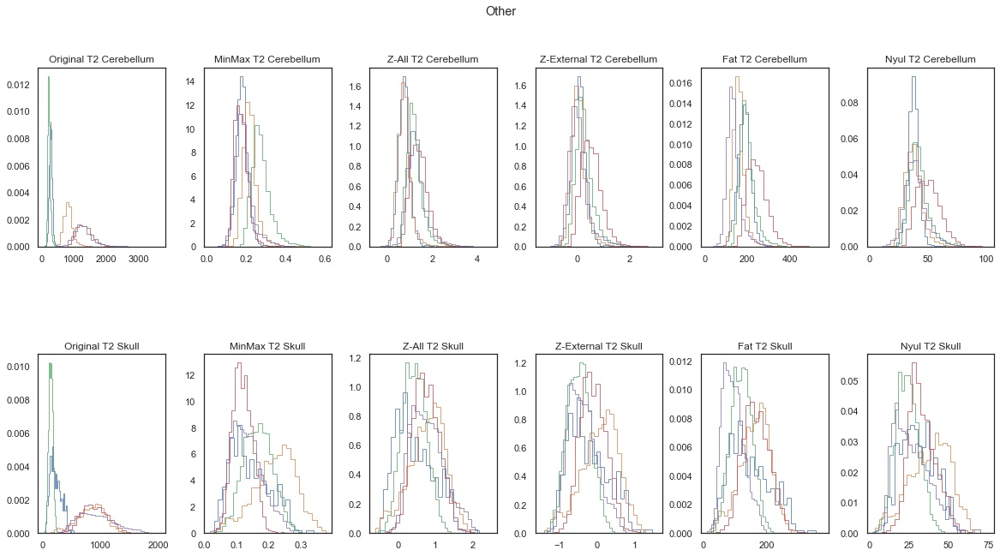

In [61]:
plot_histograms(method_list_HET, tuple_list_HET, df_image_new_HET, df_mask_HET)

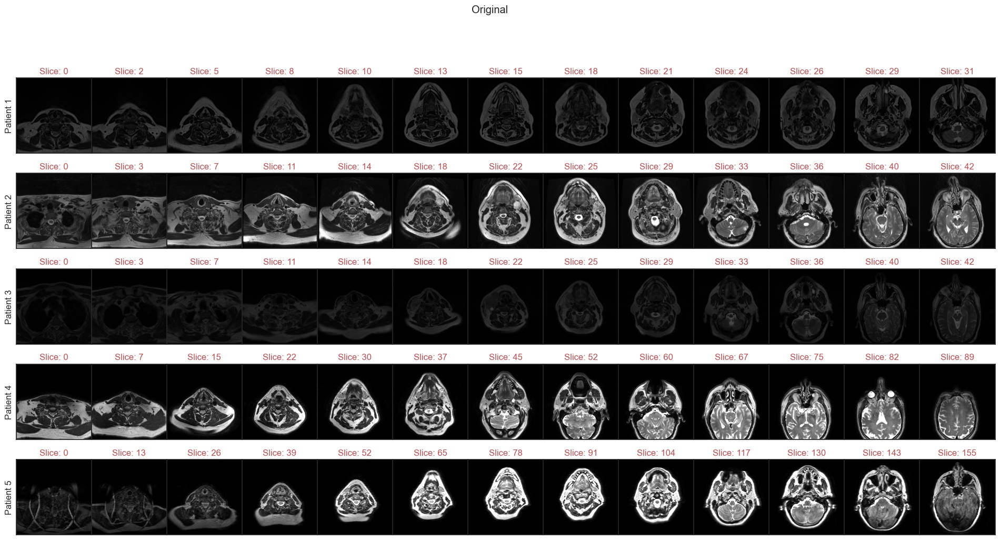

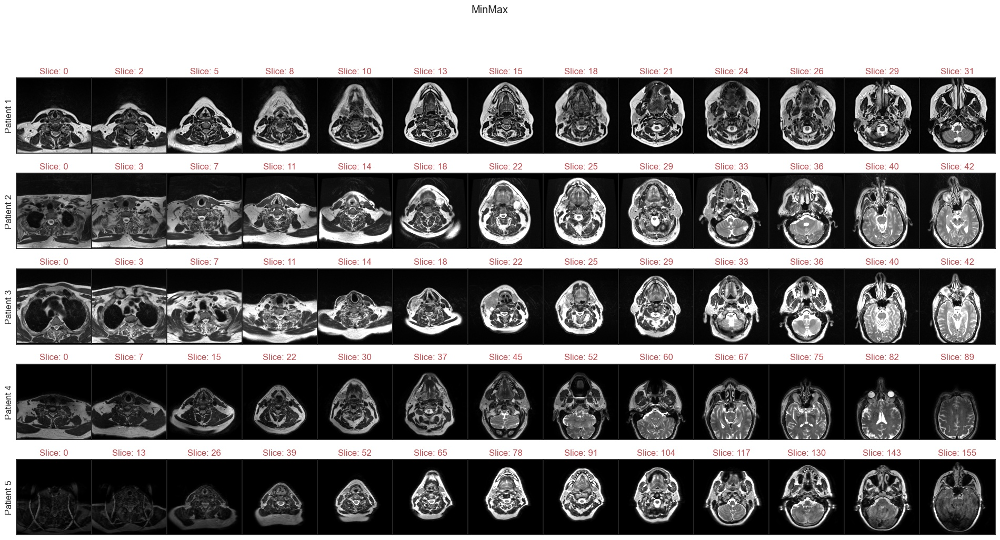

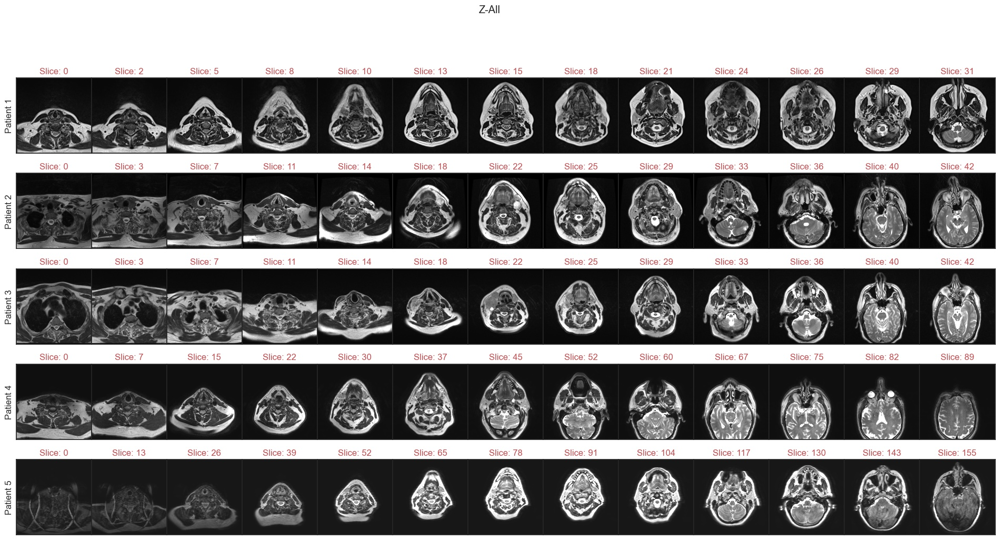

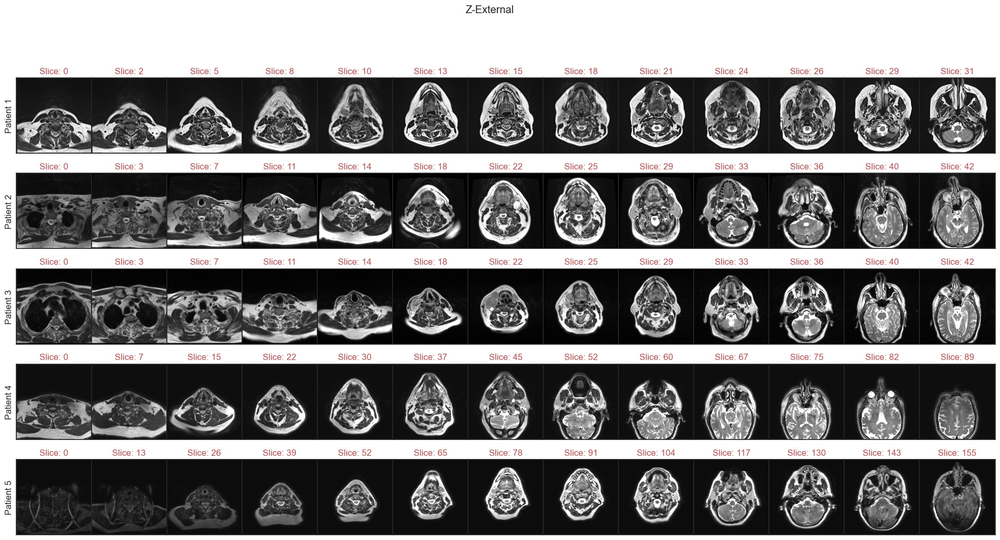

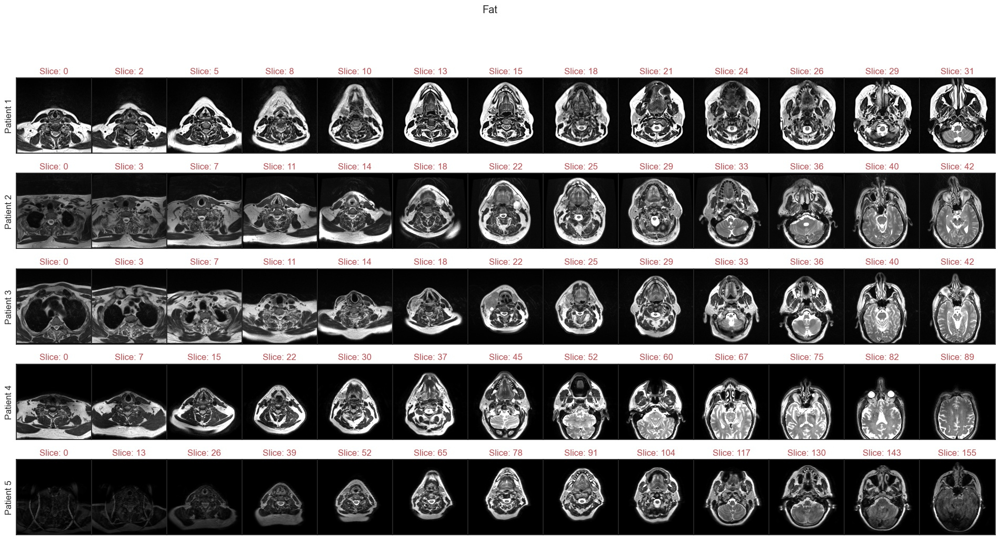

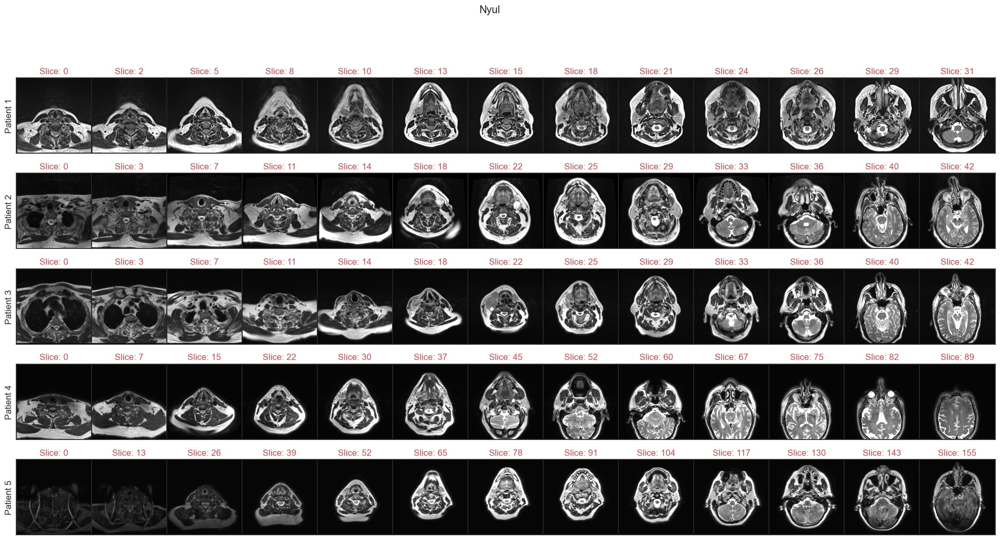

In [62]:
plot_all_images(method_list_HET, df_image_new_HET)

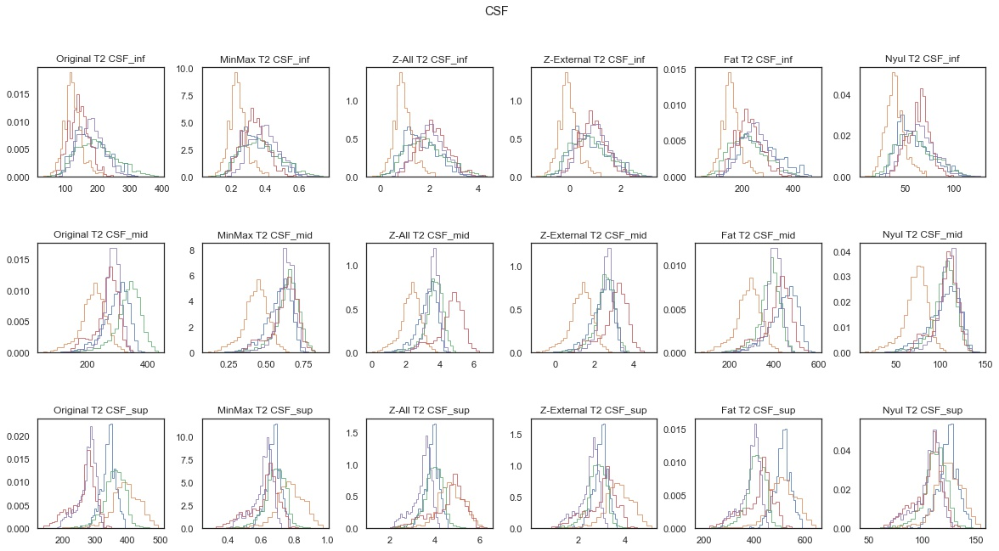

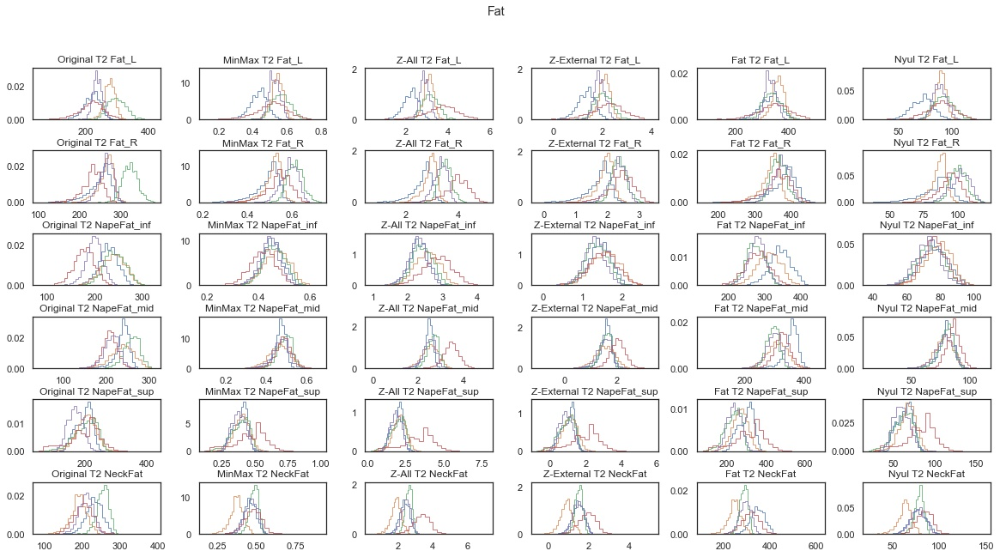

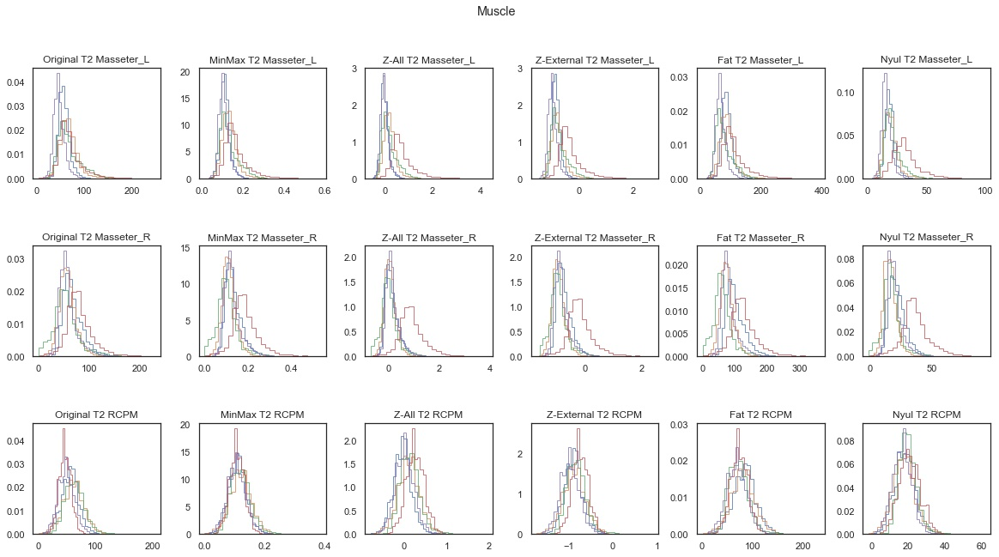

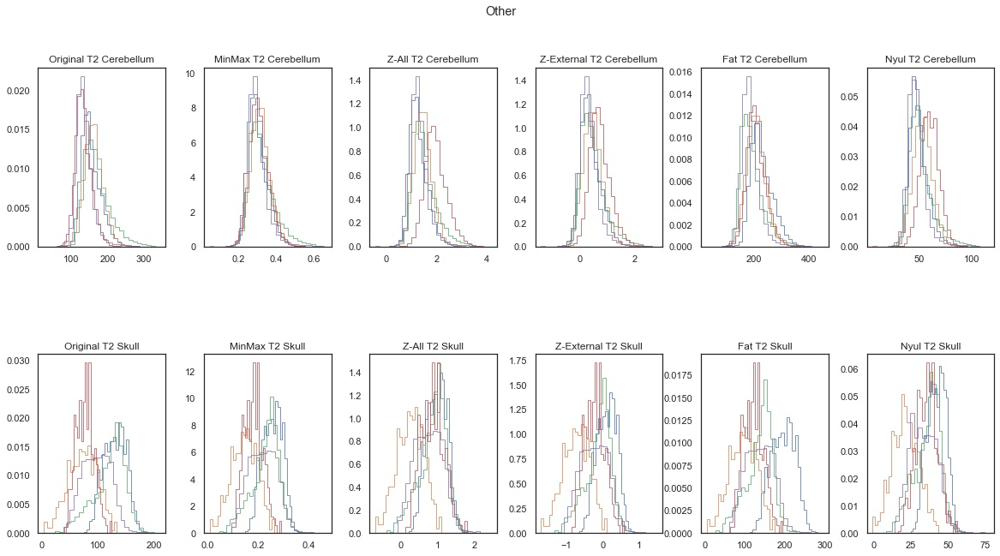

In [63]:
plot_histograms(method_list_HOM, tuple_list_HOM, df_image_new_HOM, df_mask_HOM)

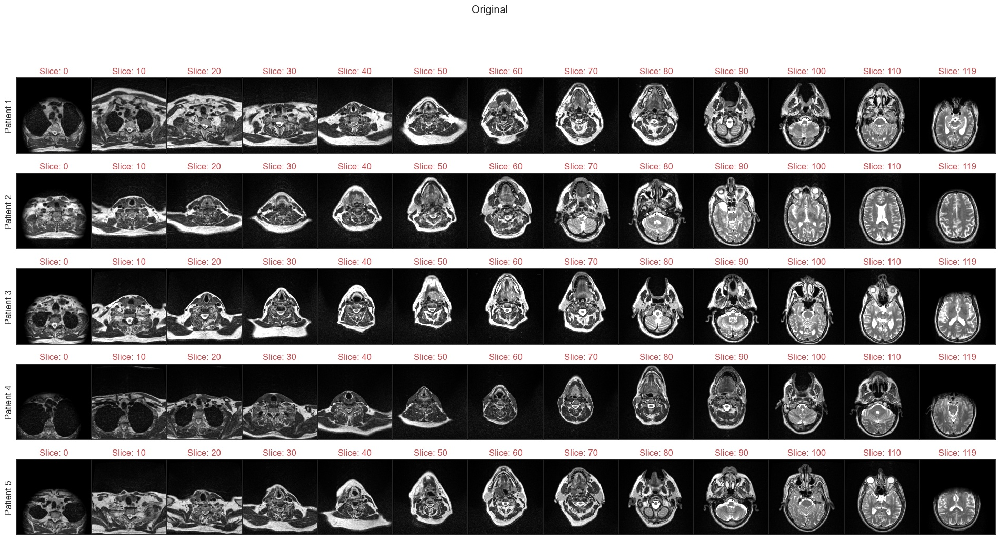

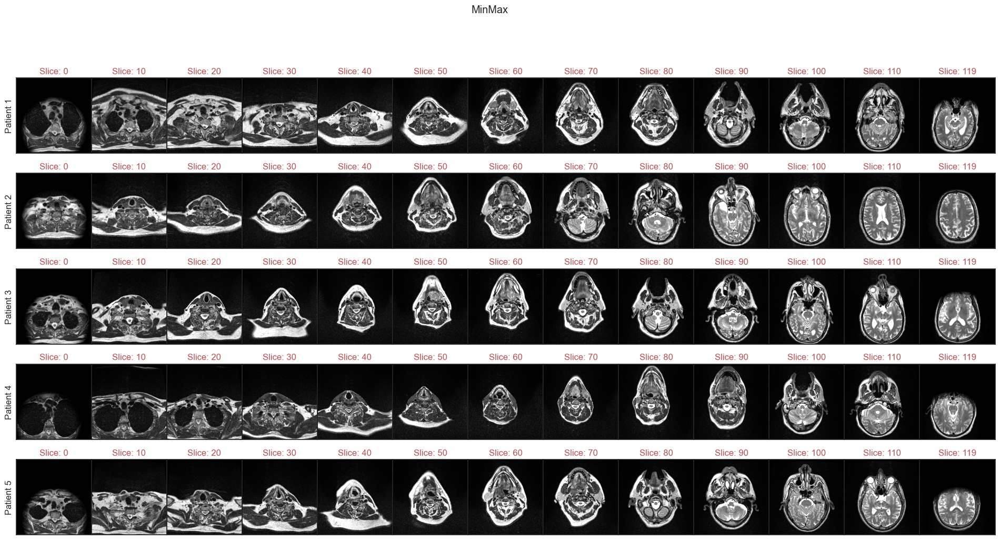

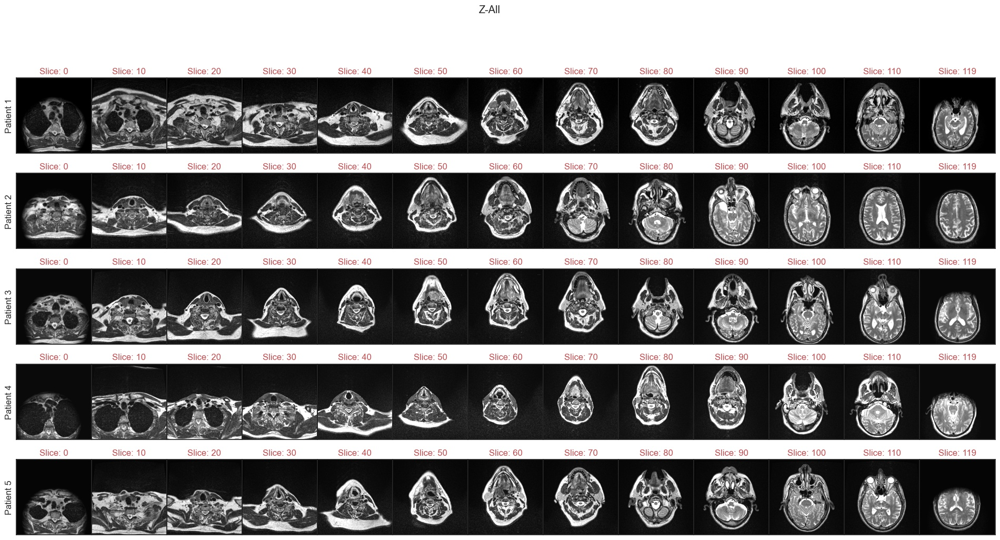

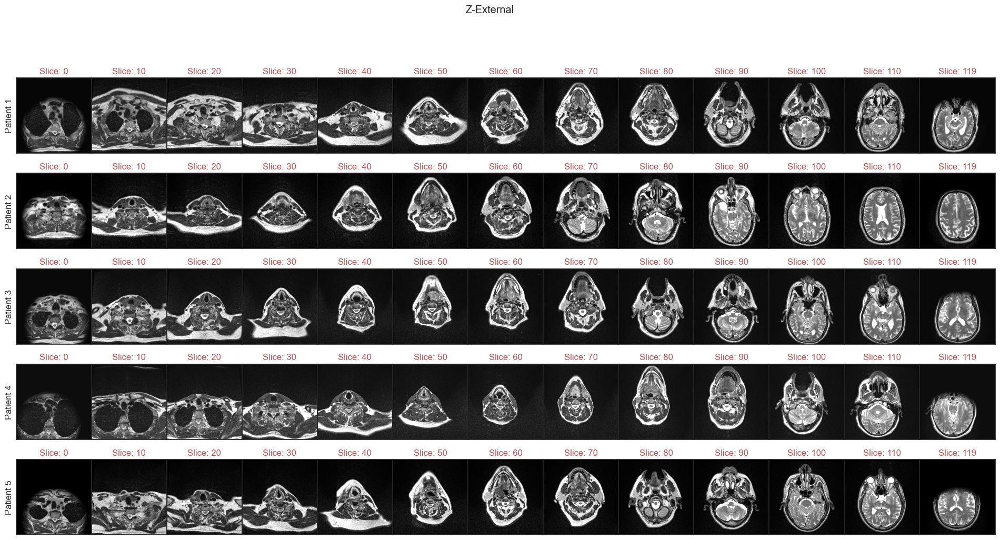

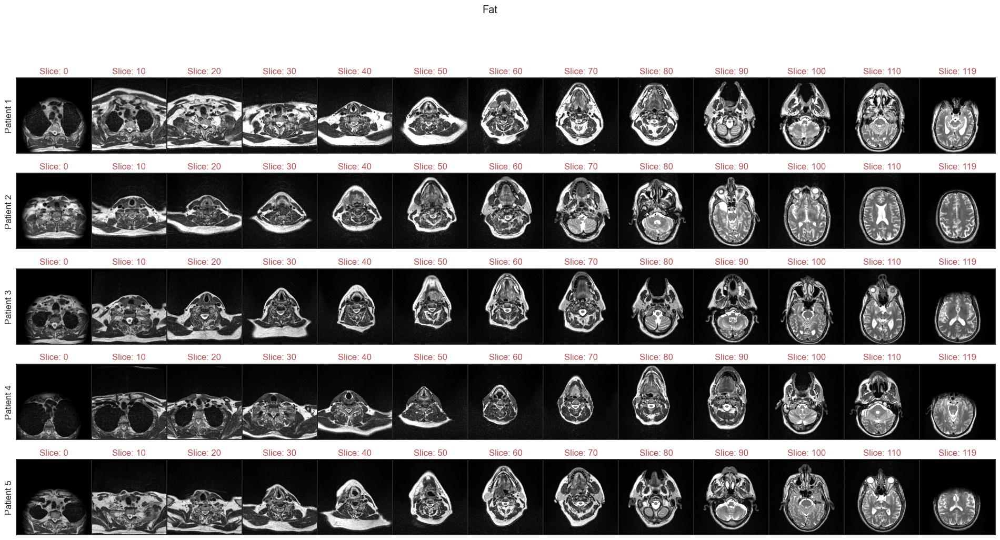

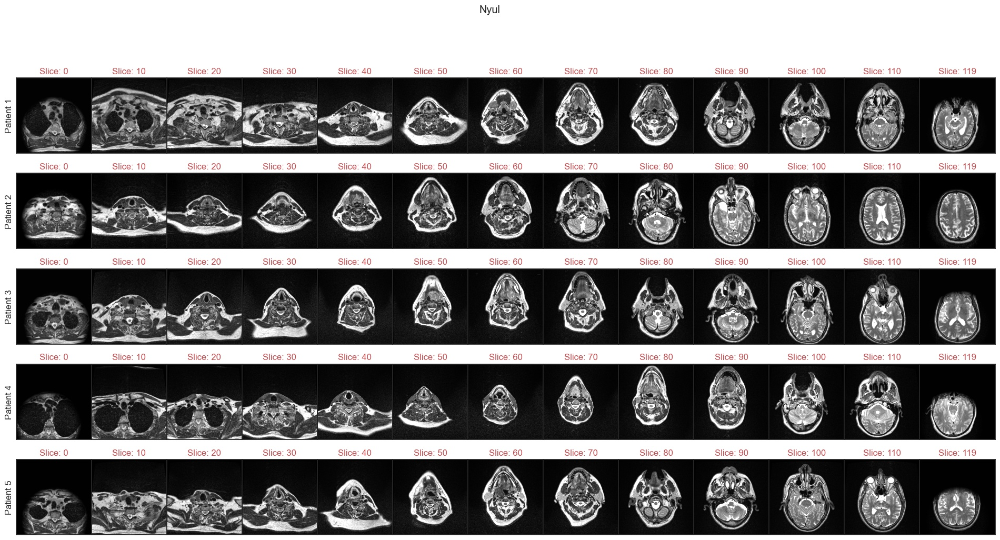

In [64]:
plot_all_images(method_list_HOM, df_image_new_HOM)

In [85]:
# pyradiomics has a feature that prints warnings every time a fixed bin width is used, making the notebook very messy
# to remove warnings from pyradiomics run this cell before the radiomics cells then rerun this cell again
sys.stderr = open(os.devnull, "w") # silence stderr, https://stackoverflow.com/questions/52224813/python-warnings-filterwarnings-does-not-ignore-deprecationwarning-from-import-s

Note: Radiomic calculations/functions take about 30 minutes to compute for each cohort. 

In [66]:
%%time
radiomics_df_HET = radiomic(method_list_HET, tuple_list_HET, df_image_new_HET, df_mask_HET)

Wall time: 17min 20s


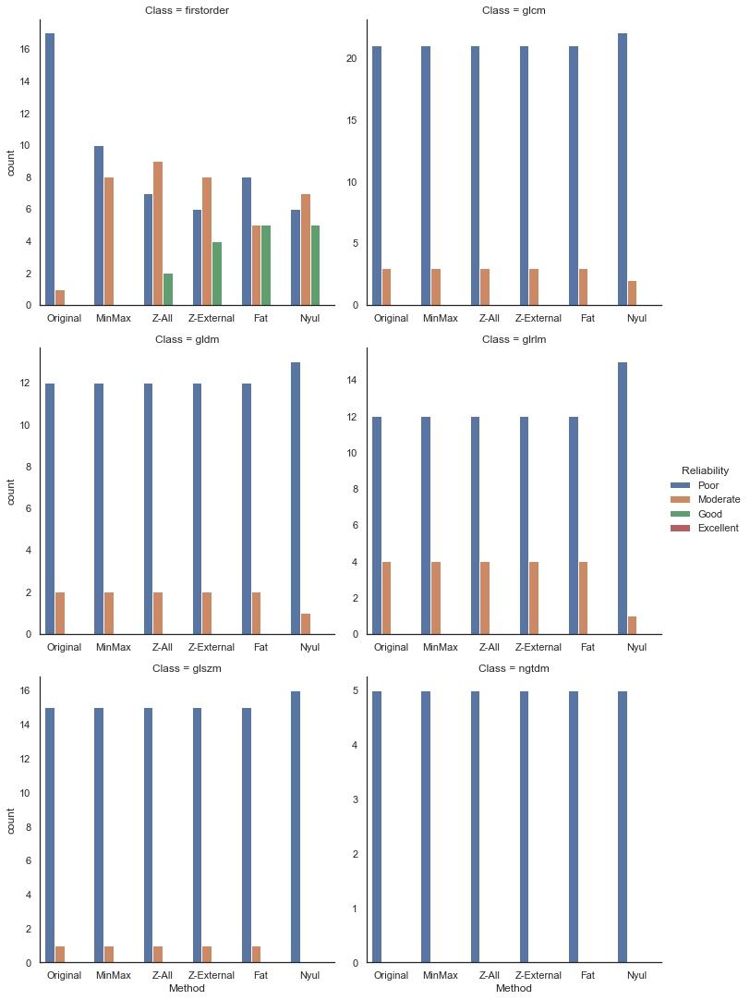

In [67]:
plot_radiomic_ICC(method_list_HET, radiomics_df_HET)

In [68]:
%%time
radiomics_df_HOM = radiomic(method_list_HOM, tuple_list_HOM, df_image_new_HOM, df_mask_HOM)

Wall time: 29min 55s


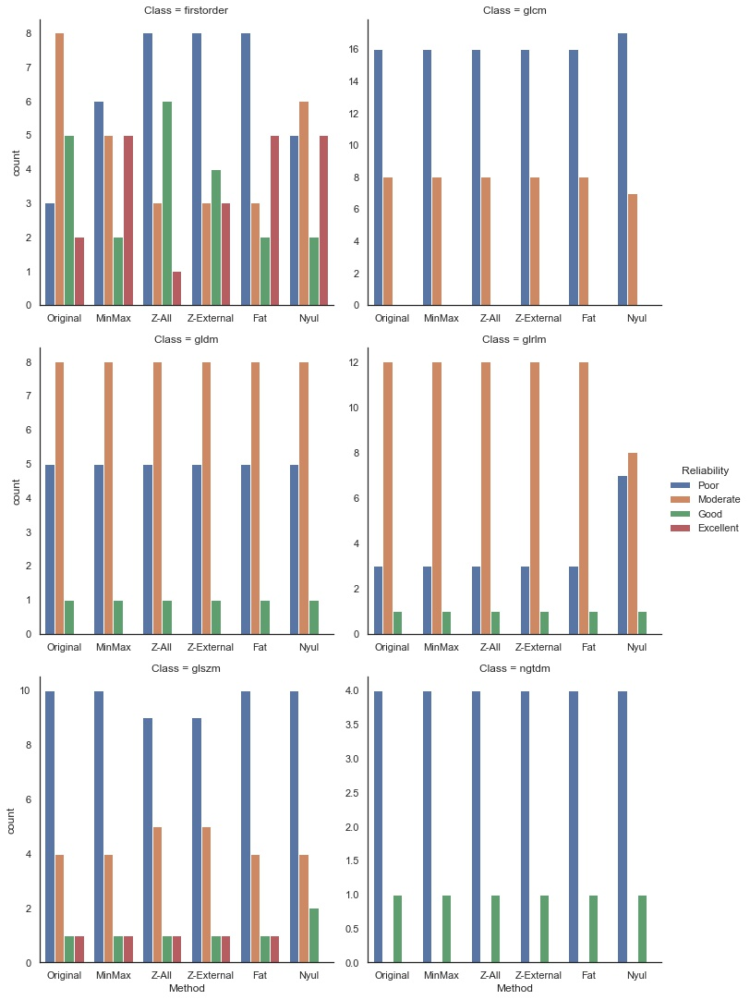

In [69]:
plot_radiomic_ICC(method_list_HOM, radiomics_df_HOM)

## Complete T1-w Dixon data (histograms, images, SD NMIc) <a name="T1"></a>

In [70]:
%%time
%%capture
ROI_list_T1  = ['Parotid_L', 'Parotid_R', 
            'Fat_L', 'Fat_R','NapeFat_inf', 'NapeFat_mid', 'NapeFat_sup','NeckFat',
             'External']

path_T1 = os.path.join('.', 'HOM_cohort') # HOM cohort
path2_T1 = os.path.join('.', 'HOM_cohort_nyul')

method_list_T1 = ['Original', 'MinMax', 'Z-All', 'Z-External', 'Fat', 'Nyul']

tuple_list_T1, fat_left_index_T1, fat_right_index_T1, external_index_T1, df_image_T1, df_mask_T1 = dicom_to_numpy(ROI_list_T1, path_T1, "Dixon_F")
df_image_new_T1 = standardization(method_list_T1, df_image_T1, df_mask_T1, fat_left_index_T1, fat_right_index_T1, external_index_T1, path2_T1)

Wall time: 1min 12s


In [71]:
dicom_HOM_T1 = dicom_header_info(path_HOM, "Dixon_F")
dicom_HOM_T1 # display the dataframe 

,SeriesDescription,Manufacturer,ManufacturerModelName,MagneticFieldStrength,RepetitionTime,EchoTime,EchoTrainLength,FlipAngle,PixelSpacing,SliceThickness,ImagingFrequency,NumberOfAverages,PercentSampling,PixelBandwidth,AcquisitionMatrix,PixelRepresentation
0,Ax 3D T1 Dixon_W,SIEMENS,Aera,1.5,7.11,2.39,2,10.0,"[1, 1]",1.0,63.675910,2.0,100.0,405.0,"[256, 0, 0, 256]",0
1,+C Ax 3D T1 Dixon_W,SIEMENS,Aera,1.5,7.11,2.39,2,10.0,"[1, 1]",1.0,63.675971,2.0,100.0,405.0,"[256, 0, 0, 256]",0
2,Ax 3D T1 Dixon_W,SIEMENS,Aera,1.5,7.11,2.39,2,10.0,"[1, 1]",1.0,63.675922,2.0,100.0,405.0,"[256, 0, 0, 256]",0
3,+C Ax 3D T1 Dixon_W,SIEMENS,Aera,1.5,7.11,2.39,2,10.0,"[1, 1]",1.0,63.675908,2.0,100.0,405.0,"[256, 0, 0, 256]",0
4,+C Ax 3D T1 Dixon_F,SIEMENS,Aera,1.5,7.11,2.39,2,10.0,"[1, 1]",1.0,63.675907,2.0,100.0,405.0,"[256, 0, 0, 256]",0


In [72]:
df_T1 = SDNMI_calc(method_list_T1, tuple_list_T1, df_image_new_T1, df_mask_T1)

Original 0.14 ± 0.05
MinMax 0.13 ± 0.05
Z-All 0.14 ± 0.02
Z-External 0.12 ± 0.02
Fat 0.12 ± 0.05
Nyul 0.10 ± 0.02


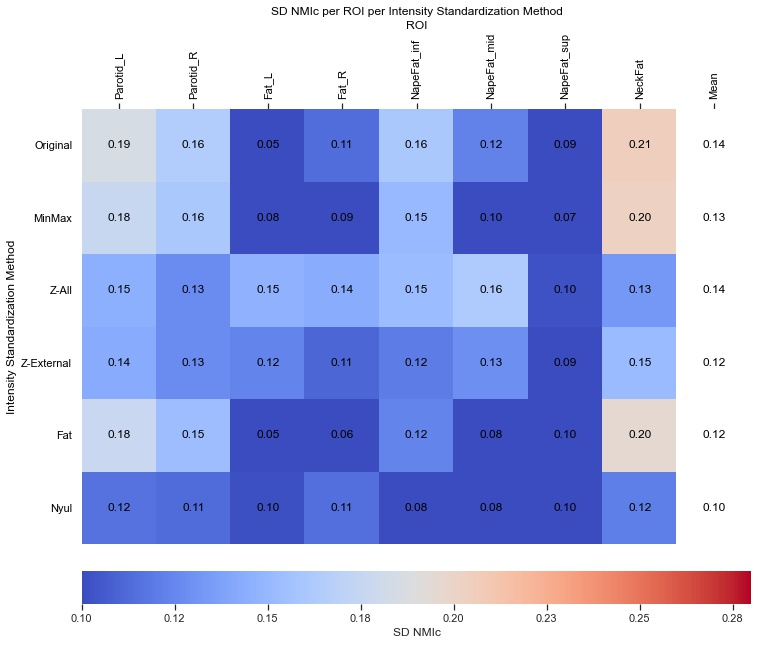

In [73]:
SDNMI_heatmap(method_list_T1, tuple_list_T1, df_T1)

In [74]:
pg.friedman(data=df_T1, dv='SD_NMI', within='Method', subject='ROI')

,Source,ddof1,Q,p-unc
Friedman,Method,5,9.0,0.109064


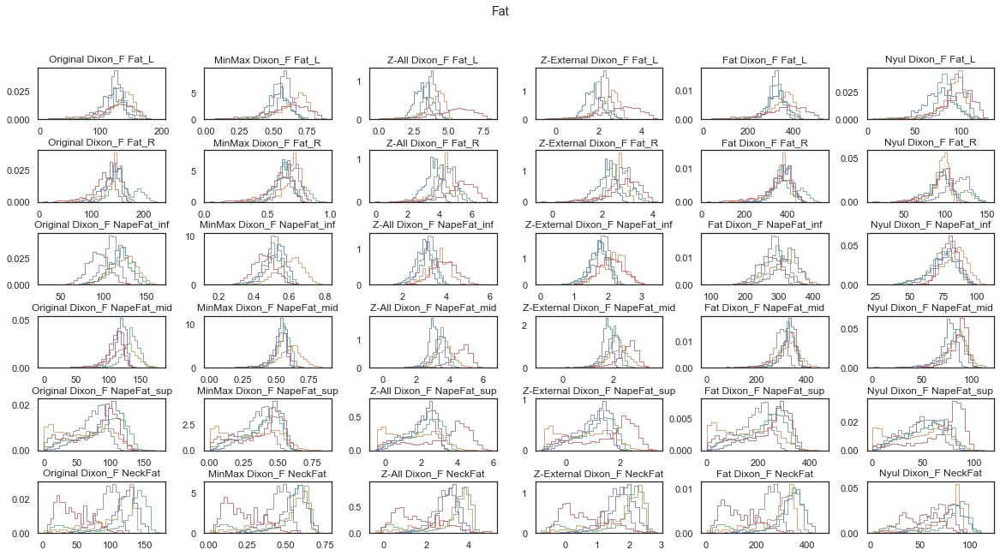

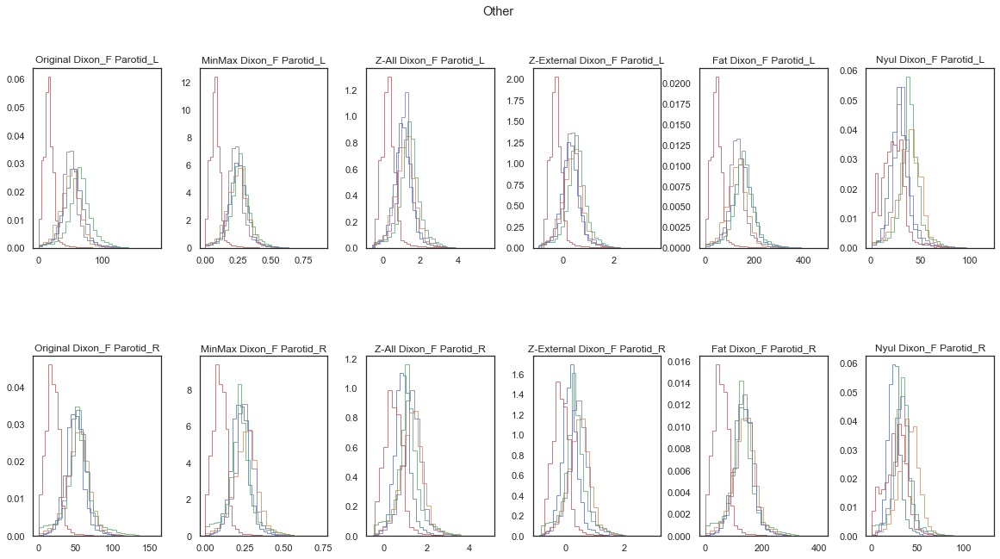

In [75]:
plot_histograms(method_list_T1, tuple_list_T1, df_image_new_T1, df_mask_T1)

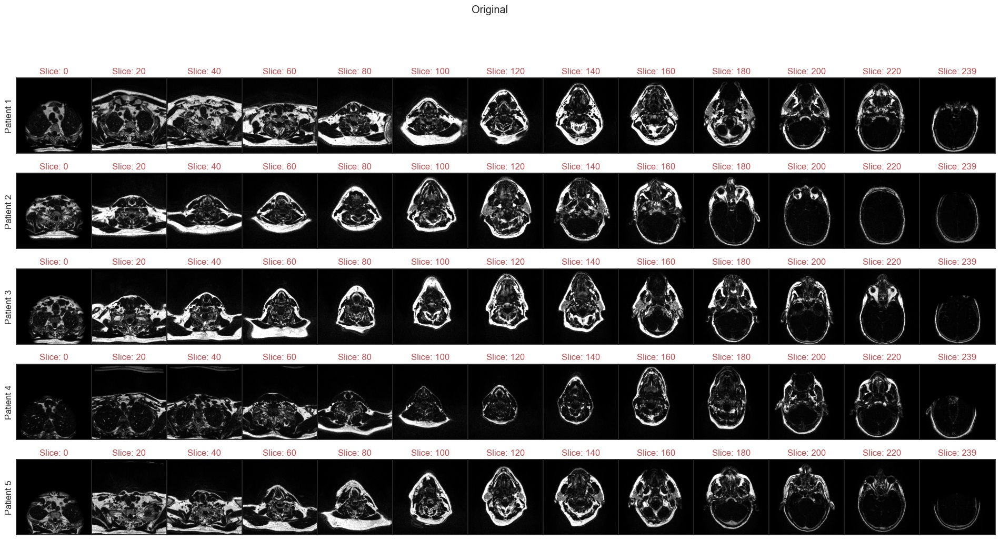

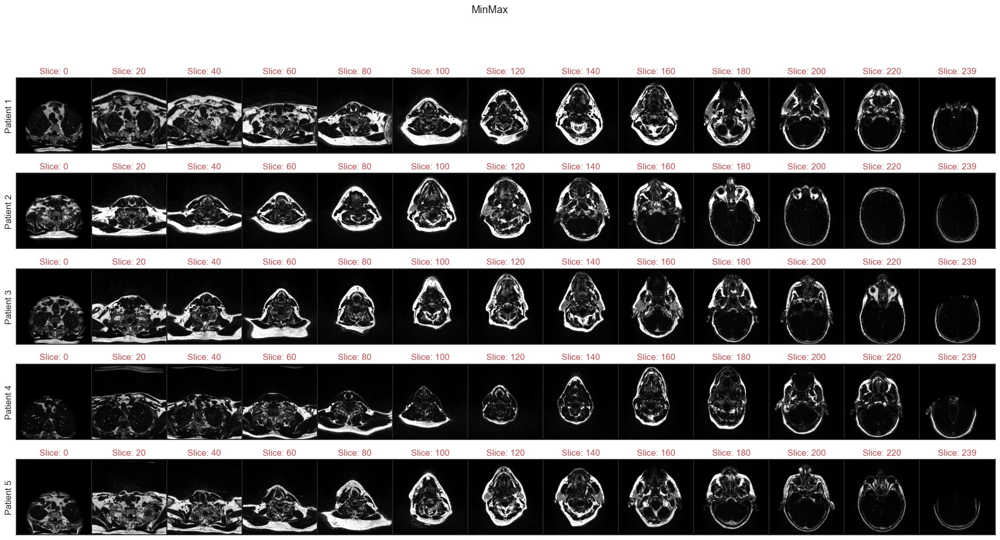

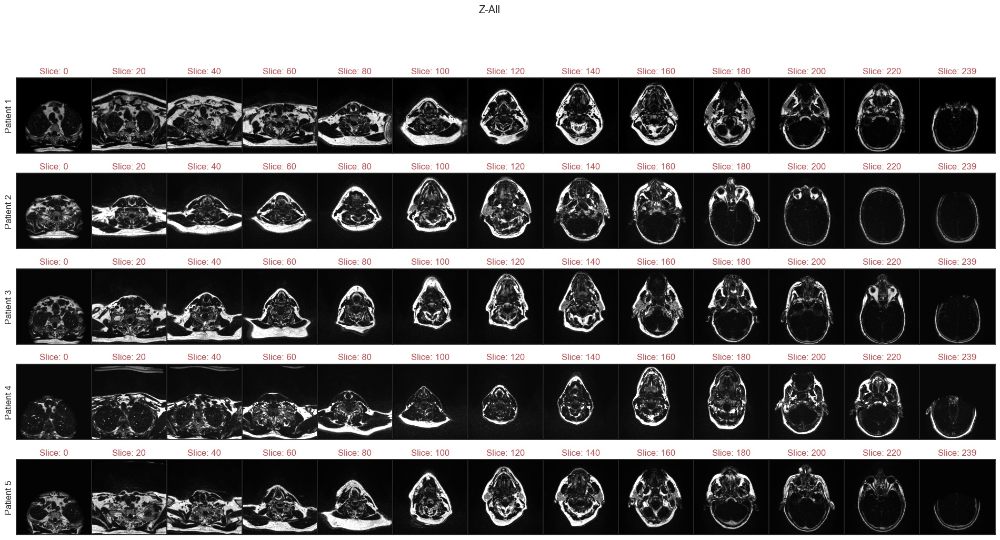

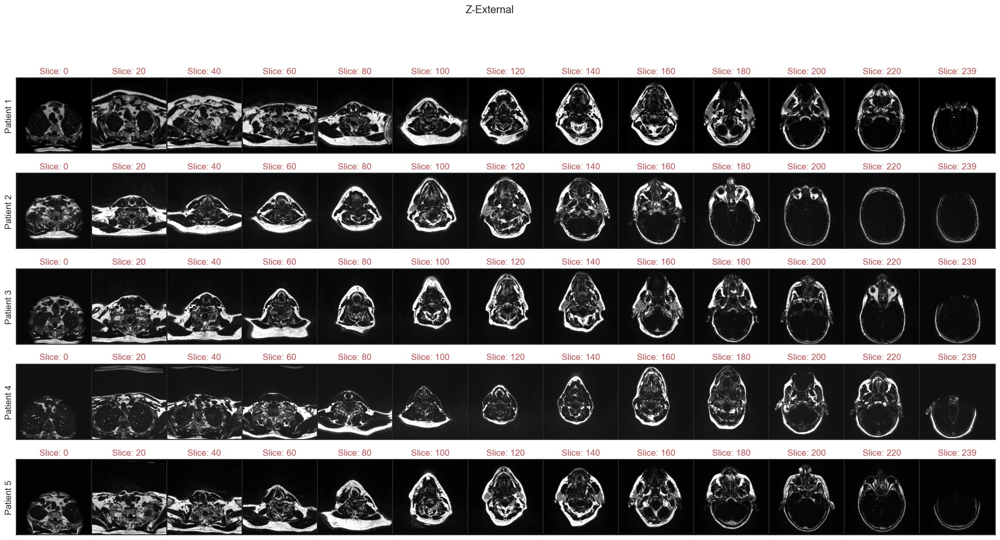

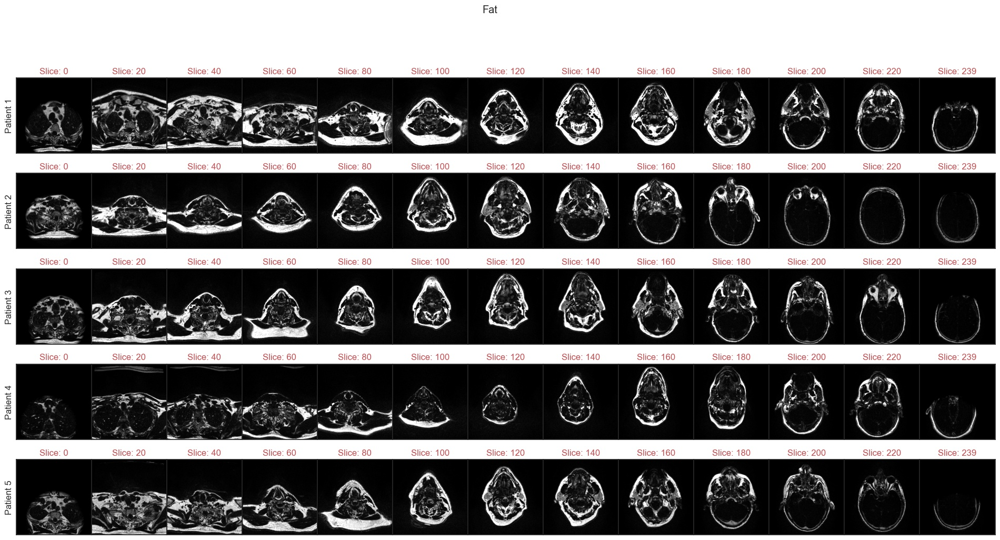

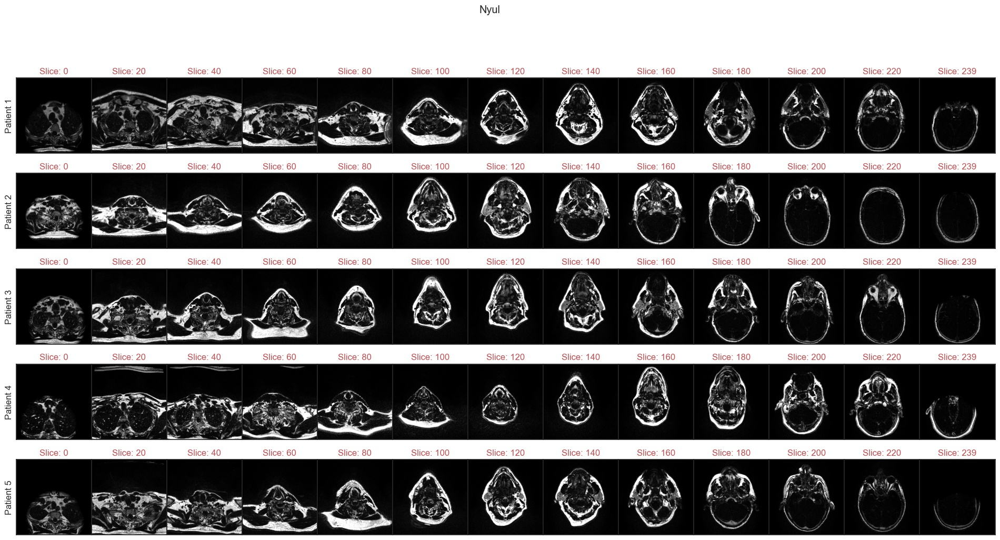

In [76]:
plot_all_images(method_list_T1, df_image_new_T1)

## Complete CT data (histograms, images, SD NMIc) <a name="CT"></a>

In [77]:
%%time
%%capture
ROI_list_CT  = ['CSF_inf', 'CSF_mid', 'CSF_sup', 
            'Fat_L', 'Fat_R','NapeFat_inf', 'NapeFat_mid', 'NapeFat_sup','NeckFat',
            'Masseter_L', 'Masseter_R','RCPM',
            'Cerebellum', 
             'Skull',
             'External']  

path_CT = os.path.join('.', 'HOM_cohort') # HOM cohort
path2_CT = os.path.join('.', 'HOM_cohort_nyul') 

method_list_CT = ['Original', 'MinMax', 'Z-All', 'Z-External', 'Fat', 'Nyul']

tuple_list_CT, fat_left_index_CT, fat_right_index_CT, external_index_CT, df_image_CT, df_mask_CT = dicom_to_numpy(ROI_list_CT, path_CT, "CT")
df_image_new_CT = standardization(method_list_CT, df_image_CT, df_mask_CT, fat_left_index_CT, fat_right_index_CT, external_index_CT, path2_CT)

Wall time: 3min 40s


In [78]:
dicom_HOM_CT = dicom_header_info(path_HOM, "CT")
dicom_HOM_CT # display the dataframe 

,SeriesDescription,Manufacturer,ManufacturerModelName,PixelSpacing,SliceThickness,Rows,Columns,KVP,ConvolutionKernel
0,Head and Neck,SIEMENS,SOMATOM Definition Edge,"[0.9765625, 0.9765625]",2.0,512,512,120.0,B40s
1,Head and Neck,SIEMENS,SOMATOM Definition Edge,"[0.9765625, 0.9765625]",2.0,512,512,120.0,B40s
2,Head and Neck,SIEMENS,SOMATOM Definition Edge,"[0.9765625, 0.9765625]",2.0,512,512,120.0,B40s
3,,Philips,Brilliance Big Bore,"[1.171875, 1.171875]",3.0,512,512,120.0,B
4,O-MAR,Philips,Brilliance Big Bore,"[1.03515625, 1.03515625]",3.0,512,512,120.0,UB


In [79]:
df_CT = SDNMI_calc(method_list_CT, tuple_list_CT, df_image_new_CT, df_mask_CT)

Original 0.11 ± 0.04
MinMax 0.13 ± 0.03
Z-All 0.29 ± 0.05
Z-External 0.16 ± 0.03
Fat 0.22 ± 0.04
Nyul 0.16 ± 0.04


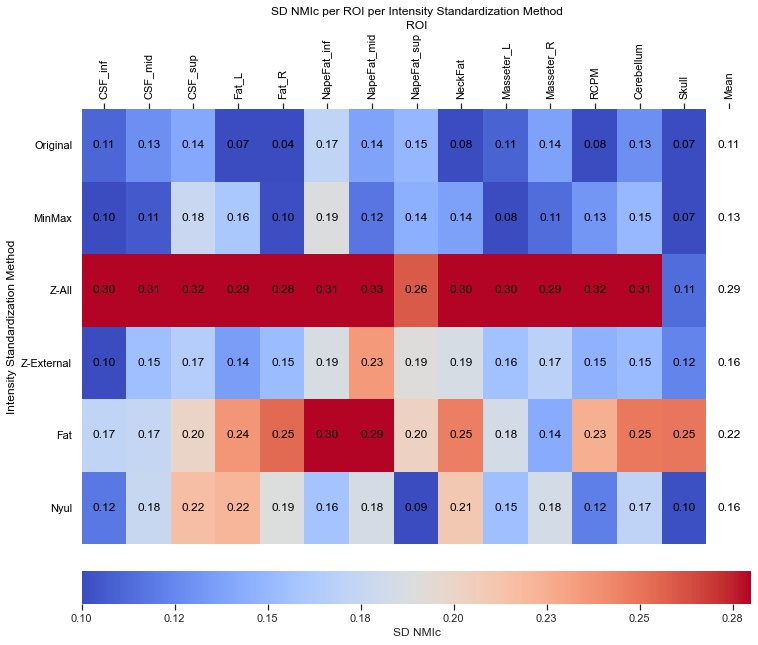

In [80]:
SDNMI_heatmap(method_list_CT, tuple_list_CT, df_CT)

In [81]:
pg.friedman(data=df_CT, dv='SD_NMI', within='Method', subject='ROI')

,Source,ddof1,Q,p-unc
Friedman,Method,5,51.673469,6.294053e-10


In [82]:
pairwise_ttests(data = df_CT, dv = "SD_NMI", subject = "ROI", within = "Method", padjust='bonf', parametric = False) 

,Contrast,A,B,Paired,Parametric,W-val,Tail,p-unc,p-corr,p-adjust,hedges
0,Method,Original,MinMax,True,False,35.0,two-sided,0.295776,1.000000,bonf,-0.399191
1,Method,Original,Z-All,True,False,0.0,two-sided,0.000122,0.001831,bonf,-3.709545
2,Method,Original,Z-External,True,False,1.0,two-sided,0.000244,0.003662,bonf,-1.359111
3,Method,Original,Fat,True,False,0.0,two-sided,0.000122,0.001831,bonf,-2.574122
4,Method,Original,Nyul,True,False,12.0,two-sided,0.008545,0.128174,bonf,-1.284186
5,Method,MinMax,Z-All,True,False,0.0,two-sided,0.000122,0.001831,bonf,-3.449694
6,Method,MinMax,Z-External,True,False,12.0,two-sided,0.008545,0.128174,bonf,-0.969462
7,Method,MinMax,Fat,True,False,0.0,two-sided,0.000122,0.001831,bonf,-2.270008
8,Method,MinMax,Nyul,True,False,12.0,two-sided,0.008545,0.128174,bonf,-0.935542
9,Method,Z-All,Z-External,True,False,1.0,two-sided,0.000244,0.003662,bonf,2.803999


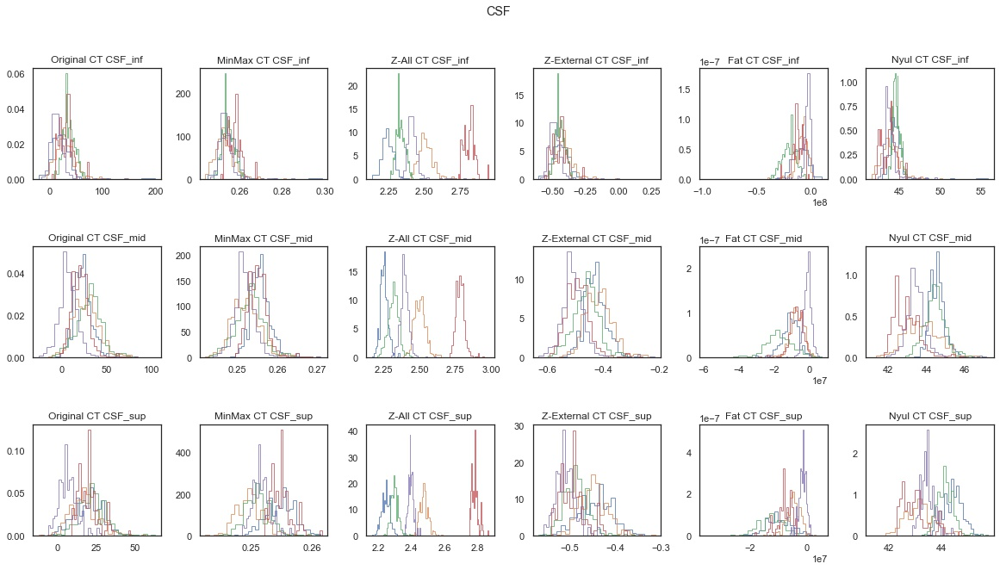

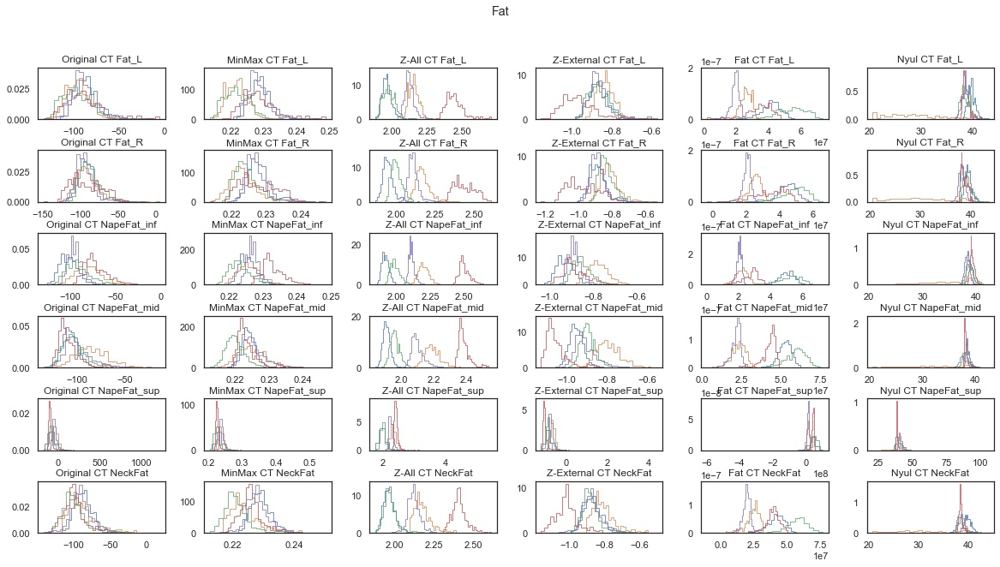

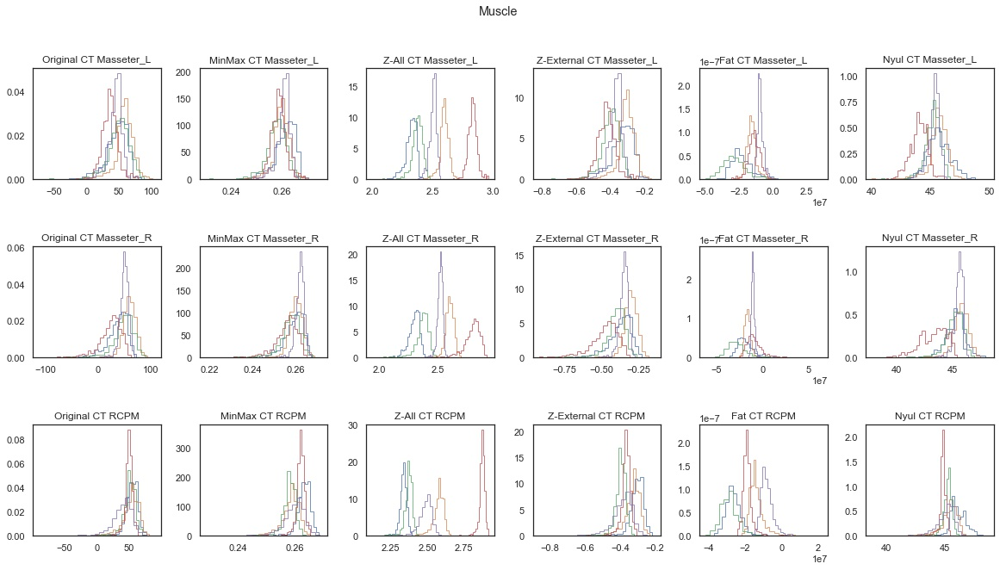

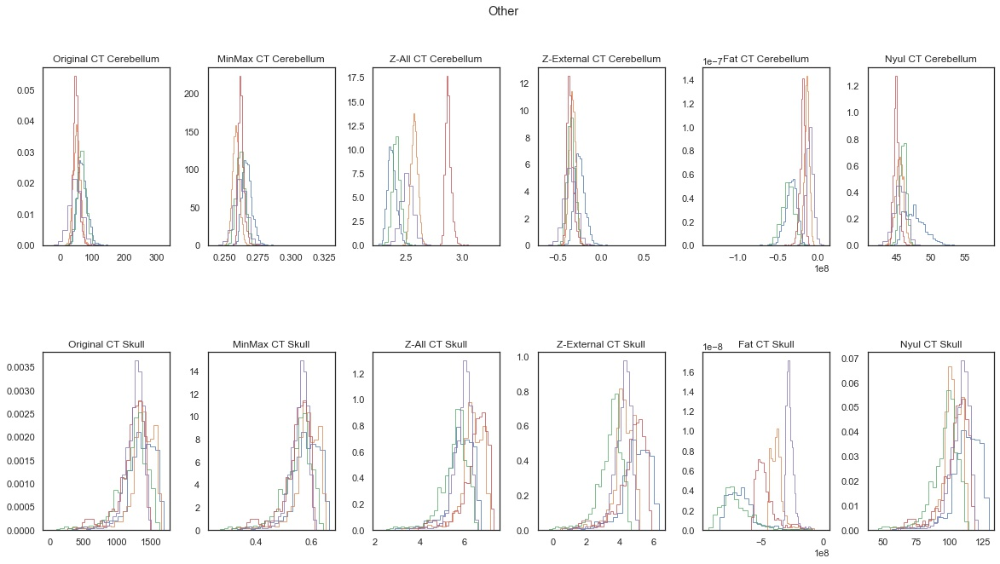

In [83]:
plot_histograms(method_list_CT, tuple_list_CT, df_image_new_CT, df_mask_CT)

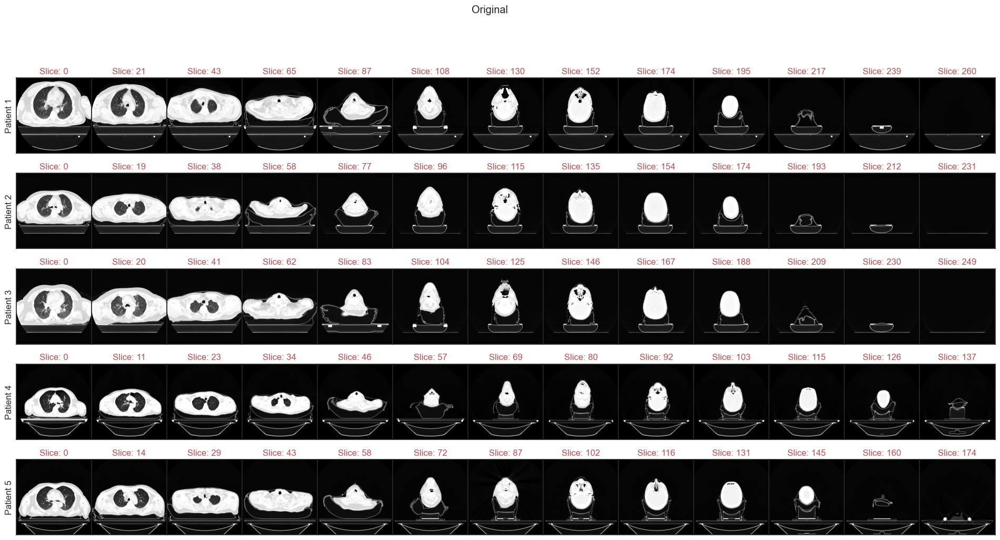

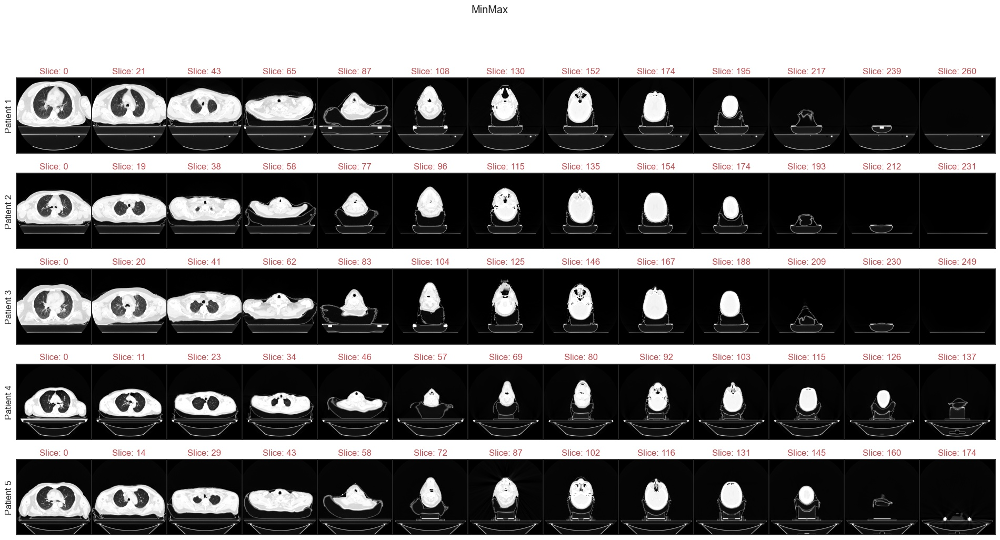

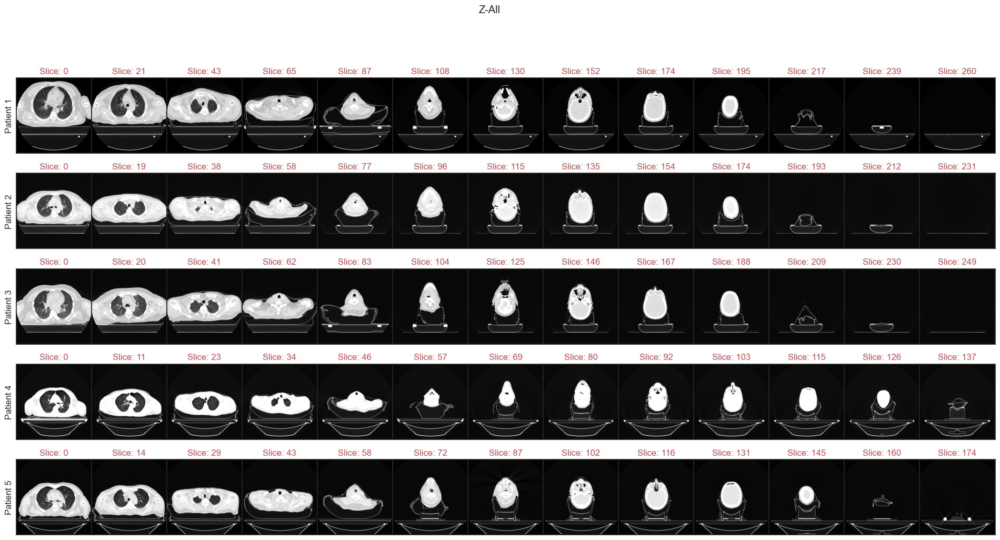

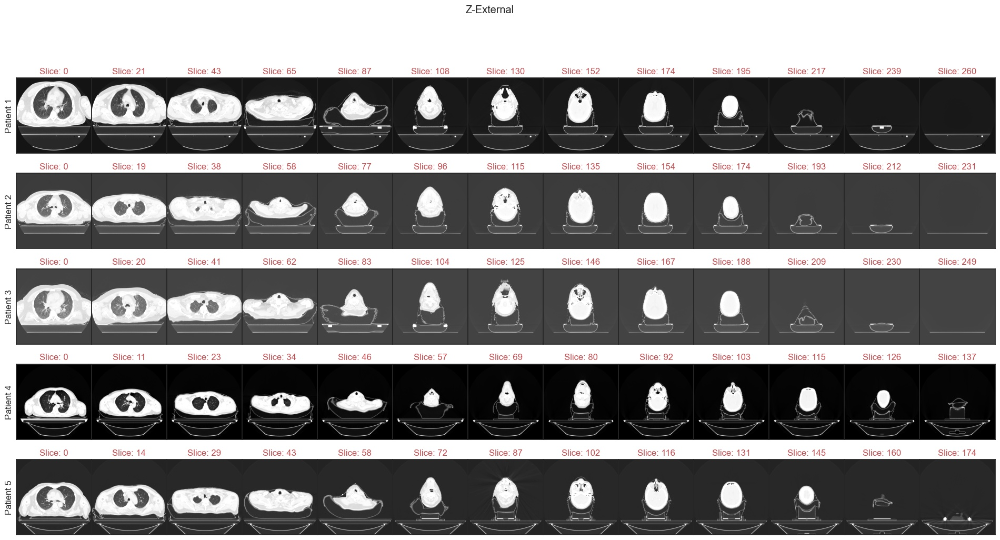

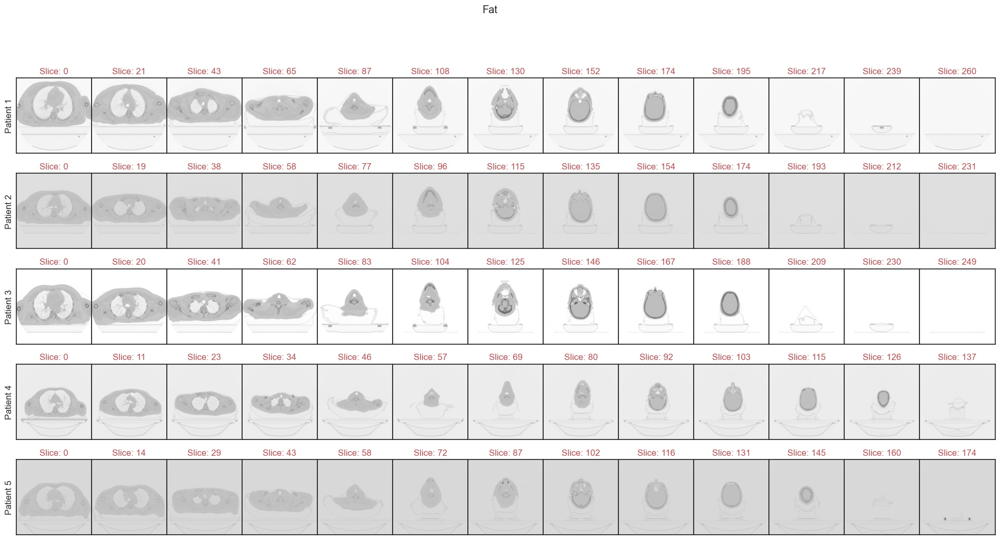

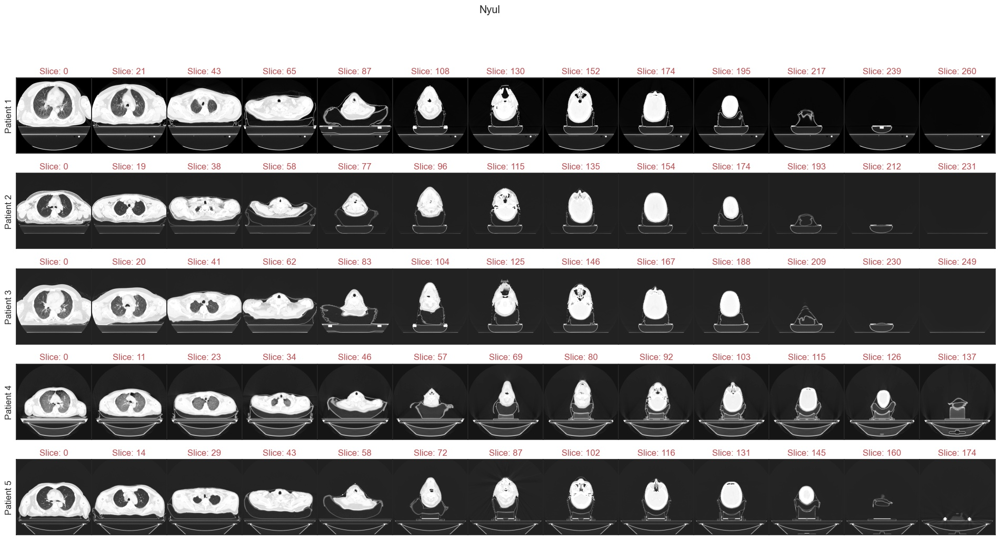

In [84]:
plot_all_images(method_list_CT, df_image_new_CT)